

## <center>**Transferring T1 MRI image to T2 MRI image and vice versa using CYCLE GAN**<center>

---
<center> By K. Pavan Kumar <center>



# **Project Pipeline**
1. **Importing Required Libraries**
2. **Data Preparation**
*   Basic EDA
*   Data Loading
*   Sample data Visualization

3. **Data Processing**
*   Data normalization
*   Data resizing
*   Data reshaping
*   Batch and shuffling of data
4. **Model Building**
*   Instance Normalization
*   Downsampling, Upsampling and Unet
*   Generator Creation
*   Discriminator Creation
5. **Model Training**
* Checking output of Untrained Generators
* Creating Loss Functions for GAN:
** Binary Cross Entropy
** Discriminator Loss
** Generator Loss
** Cycle Loss
** Identity Loss
* Optimizer
* Checkpoint Initialization
* Creating Function for generating Images while Training GAN
6. **Training Flow**
* Creating Train Function for GAN
* Training Cycle GAN
* Plotting Total Loss values of two Discriminators and two generators
7. **Generating a GIF for Visualization of results**
8. **Conclusion**















### **Importing Libraries:**

In [ ]:
# Importing required Libraries
import os
from google.colab import drive

In [ ]:
import numpy as np
import pandas as pd
import imageio
from imageio import imread
import matplotlib.pyplot as plt
import seaborn as sns
import PIL
from PIL import Image
from collections import Counter
import imageio
from skimage.transform import resize
import tensorflow as tf
from keras.layers import LeakyReLU
import glob

### **Data Preparation:**

#### Basic EDA:

In [ ]:
# Google Colab Setup
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
!pip install patool

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 77.5/77.5 kB 2.5 MB/s eta 0:00:00


In [ ]:
import patoolib

In [ ]:
# Defining the file path for data
filepath='/content/gdrive/MyDrive/capstone_gan.RAR'
extractpath='/content/gdrive/MyDrive/capstone/'
os.makedirs(extractpath,exist_ok=True)

In [ ]:
# Extracting the files to specified filepath
patoolib.extract_archive(filepath,outdir=extractpath)

In [ ]:
t1path=extractpath+'/Tr1/TrainT1'
t2path=extractpath+'/Tr2/TrainT2'

In [ ]:
t1size=[]
for i in os.listdir(t1path):
  t1size.append(Image.open(t1path+'/'+i).size)
t2size=[]
for j in os.listdir(t2path):
  t2size.append(Image.open(t2path+'/'+j).size)

In [ ]:
Counter(t1size)

Counter({(181, 217): 43})

In [ ]:
Counter(t2size)

Counter({(181, 217): 46})

- From the above count, we could see that :
1.   The T1 images constitute to a total of 43 in number. Each image shape is 181 x 217
2.   The T2 images constitute to a total of 46 in number. Each image shape is 181 x 217



In [ ]:
# Declaring Batch size and Noise value
batch_size=1
noise=100

#### Data Loading

In [ ]:
t1imagespath=[]
for i in os.listdir(t1path):
  t1imagespath.append(t1path+'/'+i)
t2imagespath=[]
for j in os.listdir(t2path):
  t2imagespath.append(t2path+'/'+j)

In [ ]:
t1images=[]
t2images=[]
for i in t1imagespath:
  t1images.append(imageio.v2.imread(i))
for j in t2imagespath:
  t2images.append(imageio.v2.imread(j))

In [ ]:
t1images=np.asarray(t1images)
t2images=np.asarray(t2images)
print("The shape of concatenated images present in t1 folder as an array is: "+str(t1images.shape))
print("The shape of concatenated images present in t2 folder as an array is: "+str(t2images.shape))

The shape of concatenated images present in t1 folder as an array is: (43, 217, 181)
The shape of concatenated images present in t2 folder as an array is: (46, 217, 181)


#### Data Visualization:

(-0.5, 180.5, 216.5, -0.5)

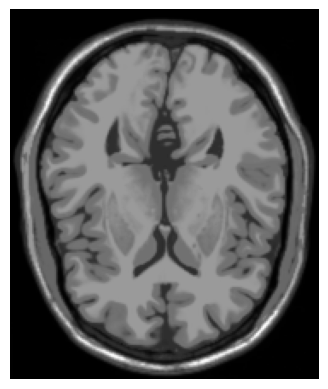

In [ ]:
# Visualizing data from t1 dataset
plt.imshow(t1images[1],cmap='gray')
plt.axis('off')

### **Data Preprocessing:**

#### Data Normalization

In [ ]:
def normalize_img(image):
  image=(image/127.5)-1.0 # Normalizing the image to range [-1.0. 1.0]
  return image

In [ ]:
t1imagesnorm=normalize_img(t1images) #normalizing t1 images
t2imagesnorm=normalize_img(t2images) #normalizing t2 images

(-0.5, 180.5, 216.5, -0.5)

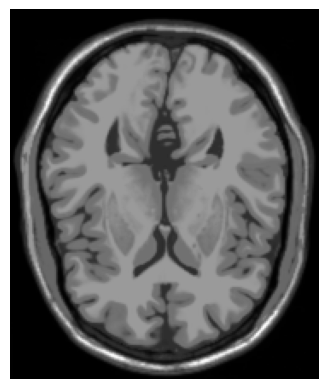

In [ ]:
plt.imshow(t1imagesnorm[1],cmap='gray')
plt.axis('off')

In [ ]:
# Number of images present in T1
t1imagesnorm.shape[0]

43

#### Data Resizing:

*   Resizing to a dimensions with a power of 2 allows optimal usage of memory.
* Thus we are resizing the image to 128 x 128

In [ ]:
def image_resize(img):
  zero_img=np.zeros((img.shape[0],128,128)) # creating a empty null array list of size 128,128 and number equivalent to number of images present in t1 or t2
  for index,image in enumerate(img):
    zero_img[index,:,:]=resize(image,(128,128)) # resizing normalized image to 128 x 128 and assigning it to created empty null array of particular index.
  return zero_img

In [ ]:
t1imagesresized=image_resize(t1imagesnorm) # resizing normalized T1 imanges to 128x128
t2imagesresized=image_resize(t2imagesnorm) # resizing normalized T2 images to 128x128

In [ ]:
print("The resized shape of T1 images is: ",t1imagesresized.shape)
print("The resized shape of T2 images is: ",t2imagesresized.shape)

The resized shape of T1 images is:  (43, 128, 128)
The resized shape of T2 images is:  (46, 128, 128)


Text(0.5, 1.0, 'T1 Resized and Nomralized Image')

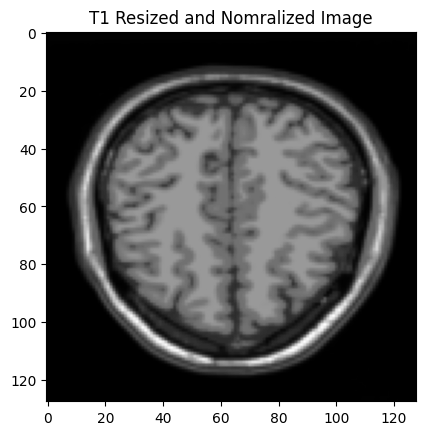

In [ ]:
# Visualizing data from T1 dataset after Normalization and resizing
sample_img1=next(iter(t1imagesresized))
plt.imshow(sample_img1,cmap='gray')
plt.title('T1 Resized and Nomralized Image')

Text(0.5, 1.0, 'T2 Resized and Normalized Image')

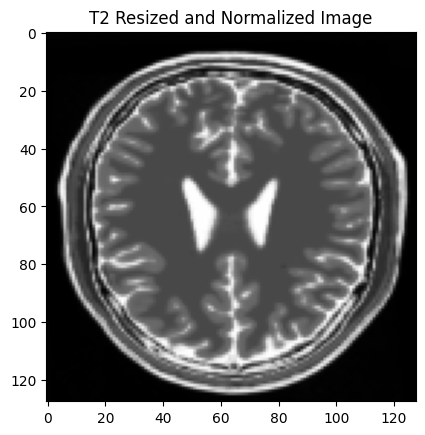

In [ ]:
# Visualizing data from T2 dataset after Normalization and resizing
sample_img2=next(iter(t2imagesresized))
plt.imshow(sample_img2,cmap='gray')
plt.title('T2 Resized and Normalized Image')

In [ ]:
t1imagesresized.shape[0]

43

#### Data Reshaping:

*  Since the MRI images are grayscale in nature, a single channel is present in the images of the dataset.
* While reshaping, we have to specify that there is only one channel present in the images of the dataset.

In [ ]:
# Reshaping images to add channel dimension
t1imagesresized=t1imagesresized.reshape(t1imagesresized.shape[0],128,128,1).astype('float32')
t2imagesresized=t2imagesresized.reshape(t2imagesresized.shape[0],128,128,1).astype('float32')

In [ ]:
print("The shape of T1 images after reshaping:",t1imagesresized.shape)
print("The shape of T2 images after reshaping:",t2imagesresized.shape)

The shape of T1 images after reshaping: (43, 128, 128, 1)
The shape of T2 images after reshaping: (46, 128, 128, 1)


#### Batching and Shuffling the Data:

In [ ]:
# Batching and Shuffling the Data
t1imagesresized=tf.data.Dataset.from_tensor_slices(t1imagesresized).shuffle(t1imagesresized.shape[0],seed=42).batch(batch_size)
t2imagesresized=tf.data.Dataset.from_tensor_slices(t2imagesresized).shuffle(t2imagesresized.shape[0],seed=42).batch(batch_size)

### **Model Building**
1. Instance Normalization
2. Downsampling, Upsampling and Unet
3. Generator Creation
4. Discriminator Creation

#### Instance Normalization:


In [ ]:
class InstanceNormalization(tf.keras.layers.Layer):
   # Initialization of Objects
  def __init__(self, epsilon=1e-5):
     # calling parent's init
    super(InstanceNormalization, self).__init__()
    self.epsilon=epsilon
  def build(self, input_shape):
    self.scale=self.add_weight(name='scale',shape=input_shape[-1:],initializer=tf.random_normal_initializer(1.0,.02),trainable=True)
    self.offset=self.add_weight(name='offset',shape=input_shape[-1:],initializer='zeros',trainable=True)

  def call(self, x):
    # Compute Mean and Variance, Axes=[1,2] ensures Instance Normalization
    mean, variance = tf.nn.moments(x,axes=[1,2],keepdims=True)
    inv=tf.math.rsqrt(variance+self.epsilon)
    normalized=(x-mean)*inv
    return self.scale*normalized+self.offset

#### Downsampling:

- Downsampling is performing convolution operation on input image. It uses Conv2D layers and reduces the dimension with each new layer.

In [ ]:
# By default, instance_norm=True. If it set false, then instance normalization would not be applied on individual convolutional layers.
def downsample(filters, size, instance_norm=True):
  initializer=tf.random_normal_initializer(0.0,0.02)
  layer=tf.keras.Sequential()
   # Add Conv2d layer
  layer.add(tf.keras.layers.Conv2D(filters,size,strides=2,padding='same',kernel_initializer=initializer,use_bias=False))
  # Add Normalization layer
  if instance_norm==True:
    layer.add(InstanceNormalization())
  # Add Leaky Relu Activation
  layer.add(tf.keras.layers.LeakyReLU())
  return layer


#### Upsampling:

- Upsampling is performing deconvolution operation using Transposed Convolution (Conv2DTranspose) to get the image as an output. It uses Transposed Convolution Layers and increases the dimension.

In [ ]:
def upsample(filters, size, drop_out=False, instance_norm=True):
  initializer=tf.random_normal_initializer(0.0,0.02)
  layer=tf.keras.Sequential()
  # Add Transposed Conv2d layer
  layer.add(tf.keras.layers.Conv2DTranspose(filters, size, strides=2, padding ='same',kernel_initializer=initializer,use_bias=False))
  # Add Normalization Layer
  if instance_norm==True:
    layer.add(InstanceNormalization())
  # Conditionally add Dropout layer
  if drop_out==True:
    layer.add(tf.keras.layers.Dropout(0.5))
  # Add Relu Activation Layer
  layer.add(tf.keras.layers.ReLU())
  return layer

#### U-Net Architecture:

- U-Net architecture does convolution on image to learn its latent characteristics and also deconvolution using Convolution Transpose to obtain image.
- The convolution transpose is used to translate T1 image to T2 image and viceversa.

In [ ]:
# we are defining u net generator function which is a combination of convolution and deconvolution
def unetgenerator():
  convolution=[
      downsample(64,4,False), # No need to apply instance normalization for first layer
      downsample(128,4),
      downsample(128,4),
      downsample(256,4),
      downsample(256,4),
      downsample(512,4),
  ]
  deconvolution=[
      upsample(256,4,True),
      upsample(256,4,True),
      upsample(128,4),
      upsample(128,4),
      upsample(64,4)
  ]
  initializer=tf.random_normal_initializer(0.0,0.02)
  output=tf.keras.layers.Conv2DTranspose(1,4,strides=2,padding='same',kernel_initializer=initializer, activation='tanh') #since image pixel values are in [-1,1] range, thus we adopted 'tanh' function
  inputlayer=tf.keras.layers.Input(shape=[128,128,1])
  concatlayer=tf.keras.layers.Concatenate()
  x=inputlayer
  skipconnection=[] # List to store downsampling layers' latent information
  # Downsampling through the model
  for conv in convolution:
    x=conv(x)
    skipconnection.append(x)
  skipconnection=reversed(skipconnection[:-1])
  # Upsampling and establishing the skip connections
  for deconv, skip in zip(deconvolution,skipconnection):
    x=deconv(x)
    x=concatlayer([x,skip])  # Concat skip connections with Up-sampling layers
  x=output(x)
  return tf.keras.Model(inputs=inputlayer, outputs=x)

#### Generator Creation:

In [ ]:
# Defining generator models - The generator models for both the image types have identical structures.
generator_t1=unetgenerator() # generator_t1 converts t1 style image to t2 style image
generator_t2=unetgenerator() # generator_t2 converts t2 style image to t1 style image

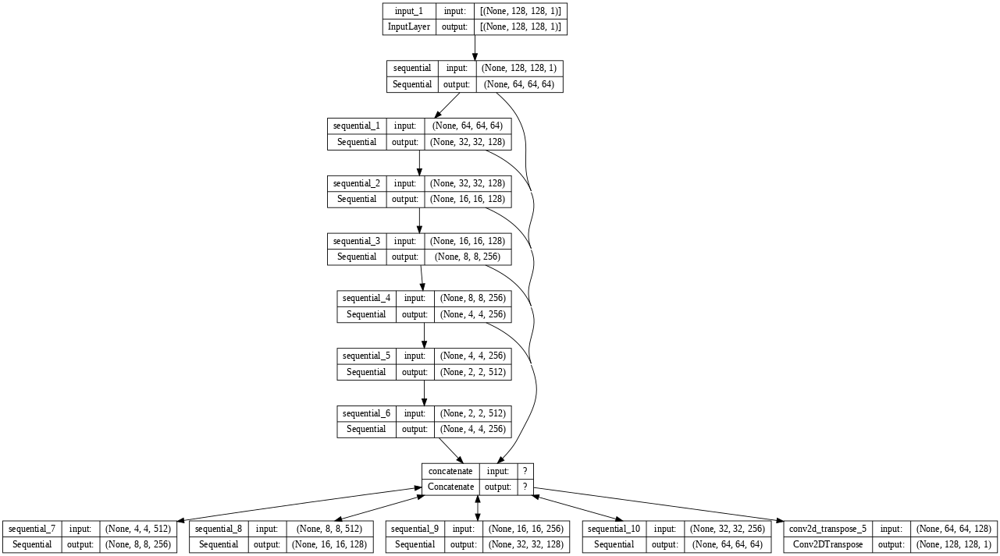

In [ ]:
# Visualize generator model architecture
tf.keras.utils.plot_model(generator_t1,show_shapes=True,dpi=64)

In [ ]:
generator_t1.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 128, 128, 1  0           []                               
                                )]                                                                
                                                                                                  
 sequential (Sequential)        (None, 64, 64, 64)   1024        ['input_1[0][0]']                
                                                                                                  
 sequential_1 (Sequential)      (None, 32, 32, 128)  131328      ['sequential[0][0]']             
                                                                                                  
 sequential_2 (Sequential)      (None, 16, 16, 128)  262400      ['sequential_1[0][0]']       

#### Discriminator Creation:

- Discriminator does only convolution operation on images and decides whether the image input it received as fake or real.

In [ ]:
# Discriminators only contain Convolutional layers and no Transposed Convolution is used.
def discriminator():
  initializer=tf.random_normal_initializer(0.0,0.02)
  input_layer=tf.keras.layers.Input(shape=[128,128,1],name='input')
  x1=input_layer
  # convolution operations are done in subsequent layers
  conv1=downsample(64,4,False)(x1)
  conv2=downsample(128,4)(conv1)
  conv3=downsample(256,4)(conv2)
  # adding a zero padding layer to ensure spatial dimensionality of convoluted image
  zeropad1=tf.keras.layers.ZeroPadding2D()(conv3)
  # Applying convolution operation
  conv4=tf.keras.layers.Conv2D(512,4,strides=1,kernel_initializer=initializer,use_bias=False)(zeropad1)
  # Applying Instance Normalization
  norm1=InstanceNormalization()(conv4)
  leakyrelu=tf.keras.layers.LeakyReLU()(norm1)
  # Applying another zero padding layer
  zeropad2=tf.keras.layers.ZeroPadding2D()(leakyrelu)
  # Applying last convolution operation
  conv5=tf.keras.layers.Conv2D(1,4,strides=1,kernel_initializer=initializer)(zeropad2)
  return tf.keras.Model(inputs=input_layer,outputs=conv5)

In [ ]:
# Defining discriminators
discriminator_t1=discriminator()
discriminator_t2=discriminator()

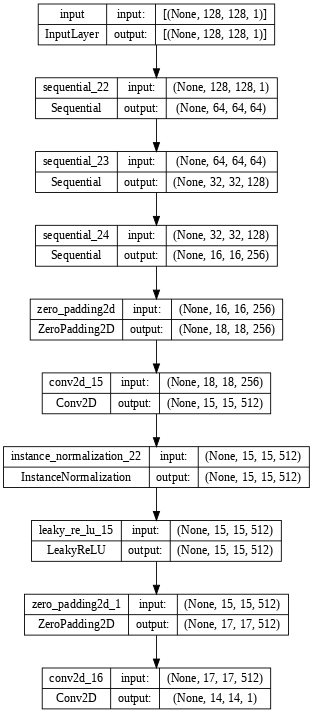

In [ ]:
# Visualize discriminator model architecture
tf.keras.utils.plot_model(discriminator_t1,show_shapes=True,dpi=64)

In [ ]:
discriminator_t1.summary()

Model: "model_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input (InputLayer)          [(None, 128, 128, 1)]     0         
                                                                 
 sequential_22 (Sequential)  (None, 64, 64, 64)        1024      
                                                                 
 sequential_23 (Sequential)  (None, 32, 32, 128)       131328    
                                                                 
 sequential_24 (Sequential)  (None, 16, 16, 256)       524800    
                                                                 
 zero_padding2d (ZeroPadding  (None, 18, 18, 256)      0         
 2D)                                                             
                                                                 
 conv2d_15 (Conv2D)          (None, 15, 15, 512)       2097152   
                                                           

### **Model Training**
1. Checking output of Untrained Generators
2. Creating Loss Functions for GAN:
* Binary Cross Entropy
* Discriminator Loss
* Generator Loss
* Cycle Loss
* Identity Loss
3. Optimizer
4. Checkpoint Initialization
5. Creating Function for Generating Images While Training GAN


#### Checking output of untrained Generators:

Text(0.5, 1.0, 'Sample T2 image produced by generator_t1')

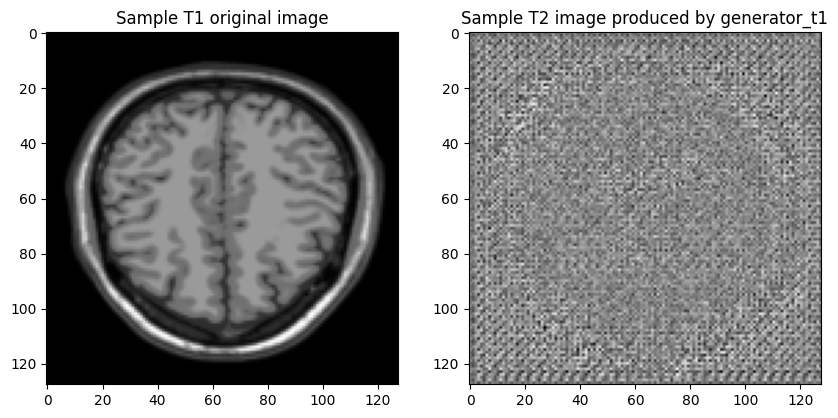

In [ ]:
# Without training, we are checking the generator_t1 function by passing a sample t1 image.
plt.figure(figsize=(10,10))
plt.subplot(1,2,1)
plt.imshow(next(iter(t1imagesresized))[0].numpy()[:,:,0],cmap='gray')
plt.title('Sample T1 original image')
plt.subplot(1,2,2)
plt.imshow(generator_t1(next(iter(t1imagesresized)))[0].numpy()[:,:,0],cmap='gray')
plt.title('Sample T2 image produced by generator_t1')

Text(0.5, 1.0, 'Sample T1 image produced by generator_t2')

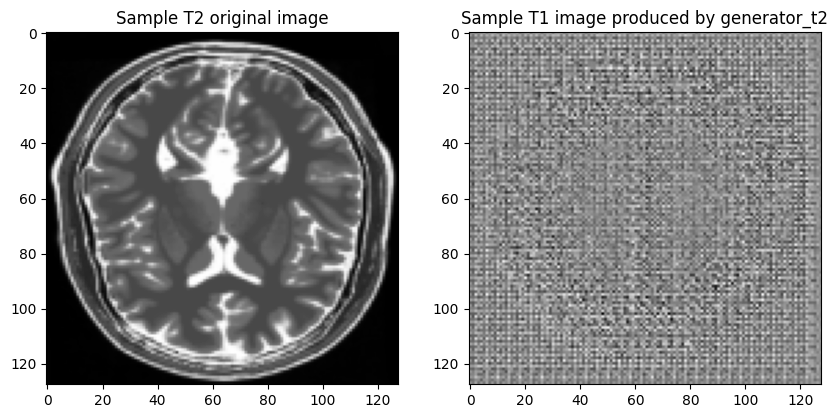

In [ ]:
# Without training, we are checking the generator_t2 function by passing a sample t2 image.
plt.figure(figsize=(10,10))
plt.subplot(1,2,1)
plt.imshow(next(iter(t2imagesresized))[0].numpy()[:,:,0],cmap='gray')
plt.title('Sample T2 original image')
plt.subplot(1,2,2)
plt.imshow(generator_t2(next(iter(t2imagesresized)))[0].numpy()[:,:,0],cmap='gray')
plt.title('Sample T1 image produced by generator_t2')

#### Creating Loss Functions for GAN:

##### Binary Cross Entropy:

In [ ]:
# We use BCE (Binary Cross Entropy) as loss function for Discriminator. Since Discriminator has to decide only whether the input image to it is fake or real.
bce=tf.keras.losses.BinaryCrossentropy(from_logits=True)

##### Discriminator Loss:
*  It consist of two types of Losses
1. Loss on real Data
2. Loss on Fake data




In [ ]:
# Discriminator loss is sum of Real loss (loss in identifying real picture as fake or real) and Fake loss (loss in identifying picture generated by generator as fake or real)
def discriminatorloss(realimage, generatedimage):
  realloss=bce(tf.ones_like(realimage),realimage)
  fakeloss=bce(tf.zeros_like(generatedimage),generatedimage)
  totaldiscriminatorloss=realloss+fakeloss
  return totaldiscriminatorloss*0.5 #0.5 is weightage factor given for total discriminator loss

##### Generator Loss:
It has only one type of loss - Discriminator Loss on Generated data

In [ ]:
# Generator loss is only loss in identifying generated images as fake or real by discriminator
def generatorloss(generatedimage):
  return bce(tf.ones_like(generatedimage),generatedimage)

##### Cycle Loss:
When we use both of Generators sequentially on a Input Image, we get Cycle Image and the L1 Loss between these two is called Cycle Loss.

In [ ]:
# Cycle loss is the loss when both the generators are used (i.e., A is converted to B and B is converted to A. This A will be compared to original input)
# L1 loss is used to calculate between original input and image generated after using both generators.
def cycleloss(realimage,cycledimage):
  cycleloss1=tf.reduce_mean(tf.abs(realimage-cycledimage))
  return cycleloss1*10.0 #10.0 is the weightage factor for cycle loss

##### Identity Loss:
When we provide input image to the Generator such that no translation is needed because the image is already transformed, the difference should be minimal between original and generated image. Here also we take L1 Loss between input and output image.

In [ ]:
# Identity loss is the loss between same class image provided as input to generator (suppose at T2 image provided as input to generator which converts T1 to T2) and the output generated image.
# L1 loss is used to calculate the loss between original image and output image
def identityloss(realimage,identityimage):
  identityloss1=tf.reduce_mean(tf.abs(realimage-identityimage))
  return identityloss1*0.5 # 0.5 is the weightage factor for identity loss

#### Optimizer Functions:

In [ ]:
generator_t1_optimizer=tf.keras.optimizers.Adam(2e-4,beta_1=0.5)
generator_t2_optimizer=tf.keras.optimizers.Adam(2e-4,beta_1=0.5)

discriminator_t1_optimizer=tf.keras.optimizers.Adam(2e-4,beta_1=0.5)
discriminator_t2_optimizer=tf.keras.optimizers.Adam(2e-4,beta_1=0.5)

In [ ]:
# EPOCHS
epochs=150

#### Checkpoint initialization:

In [ ]:
# Directory to keep Checkpoints at each epoch
checkpointpath='./CycleGANmodel'
checkpoint=tf.train.Checkpoint(generator_t1=generator_t1,
                               generator_t2=generator_t2,
                               discriminator_t1=discriminator_t1,
                               discriminator_t2=discriminator_t2,
                               generator_t1_optimizer=generator_t1_optimizer,
                               generator_t2_optimizer=generator_t2_optimizer,
                               discriminator_t1_optimizer=discriminator_t1_optimizer,
                               discriminator_t2_optimizer=discriminator_t2_optimizer)
checkpointmanager=tf.train.CheckpointManager(checkpoint,checkpointpath,max_to_keep=3) # saves maximum last 3 checkpoints
# if a checkpoint exists, restore the latest checkpoint
if checkpointmanager.latest_checkpoint:
  checkpoint.restore(checkpointmanager.latest_checkpoint) # restores latest checkpoint if any checkpoint exists.
  print('Restored Latest Checkpoint!')



#### Function for generating Images while Training:

In [ ]:
# Function to show Images output by Generators while Training
def generateimages(model1,input1,model2,input2):
  pred1=model1(input1)
  pred2=model2(input2)
  plt.figure(figsize=(10,5))
  l=[input1[0],pred1[0],input2[0],pred2[0]]
  t=['Input Image','Generated Image','Input Image','Generated Image']
  for i in range(4):
    plt.subplot(1,4,i+1)
    plt.title(t[i])
    plt.imshow(l[i].numpy()[:,:,0],cmap='gray')
    plt.axis('off')
  plt.savefig('Image_generated_at_epoch_{:04d}.png'.format(epoch))
  plt.show()

### **Training Flow:**
The Training function below performs one flow of batch training

Sequence of Training Flow

1. Generate Fake T2 and Cycled T1
2. Generate Fake T1 and Cycled T2
3. Generate Fake Images through T1 and T2 for Identity Loss.
4. Calculate Discriminator Loss for Disc T1 and Disc T2 on Fake Data for Generator Training.
5. Calculate Generator Loss for Geneartors T1 and T2
6. Calculate Cycled Loss on Cycled Images from step 1 and 2.
7. Calculate Total Generator Loss - Generator Loss + Cycled Loss + Identity Loss
8. Calculate Discriminator Loss on both Fake and Real Images for Disc X and Y for Disc Training.
9. Calculate the Gradients and update the weight and bias of models.

In [ ]:
dtlt1=[]
gtlt1=[]
dtlt2=[]
gtlt2=[]

#### Creating Train Function for GAN:

In [ ]:
@tf.function
def train(real_t1,real_t2):
  # persistent is set to True because the tape is used more than once to calculate the gradients.
  with tf.GradientTape(persistent=True) as tape:
    fake_t2=generator_t1(real_t1,training=True) #generator_t1 converts T1 class image to T2 class image
    cycle_t1=generator_t2(fake_t2,training=True)

    fake_t1=generator_t2(real_t2,training=True) #generator_t2 converts T2 class image to T1 class image
    cycle_t2=generator_t1(fake_t1,training=True)

    identity_t2=generator_t1(real_t2,training=True)
    identity_t1=generator_t2(real_t1,training=True)

    discriminator_real_t1=discriminator_t1(real_t1,training=True)
    discriminator_real_t2=discriminator_t2(real_t2,training=True)

    discriminator_fake_t1=discriminator_t1(fake_t1,training=True)
    discriminator_fake_t2=discriminator_t2(fake_t2,training=True)

# calculate generator loss
    generatort1loss=generatorloss(discriminator_fake_t2)
    generatort2loss=generatorloss(discriminator_fake_t1)
 # Calculate cycle loss
    totalcycleloss=cycleloss(real_t1,cycle_t1) + cycleloss(real_t2,cycle_t2)

    #Total Generator Loss = BCE loss + Cycle loss + Identity loss
    total_generator_t1_loss = generatort1loss + totalcycleloss + identityloss(real_t2,identity_t2)
    total_generator_t2_loss = generatort2loss + totalcycleloss + identityloss(real_t1,identity_t1)

    # Discriminator Loss
    discriminator_t1_loss=discriminatorloss(discriminator_real_t1,discriminator_fake_t1)
    discriminator_t2_loss=discriminatorloss(discriminator_real_t2,discriminator_fake_t2)

  # Gradients calculation for Generator and Discriminator
  generator_t1_gradients=tape.gradient(total_generator_t1_loss, generator_t1.trainable_variables)
  generator_t2_gradients=tape.gradient(total_generator_t2_loss, generator_t2.trainable_variables)

  discriminator_t1_gradients=tape.gradient(discriminator_t1_loss, discriminator_t1.trainable_variables)
  discriminator_t2_gradients=tape.gradient(discriminator_t2_loss, discriminator_t2.trainable_variables)

  # Applicaiton of graidents to Generator and Discriminator
  generator_t1_optimizer.apply_gradients(zip(generator_t1_gradients, generator_t1.trainable_variables))
  generator_t2_optimizer.apply_gradients(zip(generator_t2_gradients, generator_t2.trainable_variables))

  discriminator_t1_optimizer.apply_gradients(zip(discriminator_t1_gradients, discriminator_t1.trainable_variables))
  discriminator_t2_optimizer.apply_gradients(zip(discriminator_t2_gradients, discriminator_t2.trainable_variables))

  return total_generator_t1_loss, total_generator_t2_loss, discriminator_t1_loss, discriminator_t2_loss

In [ ]:
# verifying for GPU
tf.compat.v1.Session(config=tf.compat.v1.ConfigProto(log_device_placement=True))

Device mapping:
/job:localhost/replica:0/task:0/device:GPU:0 -> device: 0, name: Tesla T4, pci bus id: 0000:00:04.0, compute capability: 7.5



#### Training Cycle GAN:

In [ ]:
# we are selecting 1 image of T1 style and 1 image of T2 style and reshaping, resizing them accordingly.
t1trainimagereshape=image_resize(t1imagesnorm)[0]
t2trainimagereshape=image_resize(t2imagesnorm)[0]
t1trainimage=t1trainimagereshape.reshape((1,128,128,1)).astype('float32')
t2trainimage=t2trainimagereshape.reshape((1,128,128,1)).astype('float32')
# converting to tensor dataset format
t1trainimagedata=tf.data.Dataset.from_tensor_slices(t1trainimage*10).batch(4) # single image of T1 style is augmented to 10 images in total and 4 of them will be taken as a batch during generation of images.
t2trainimagedata=tf.data.Dataset.from_tensor_slices(t2trainimage*10).batch(4) # single image of T2 style is augmented to 10 images in total and 4 of them will be taken as a batch during generation of images.

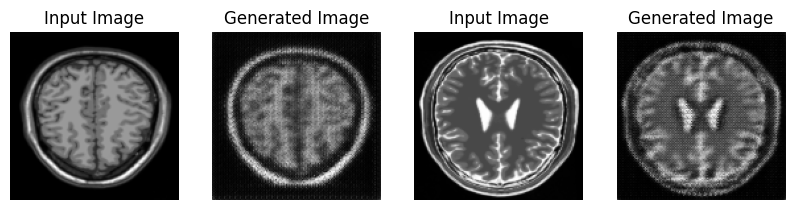

Checkpoint Saving for the epoch run  1 at ./CycleGANmodel/ckpt-1


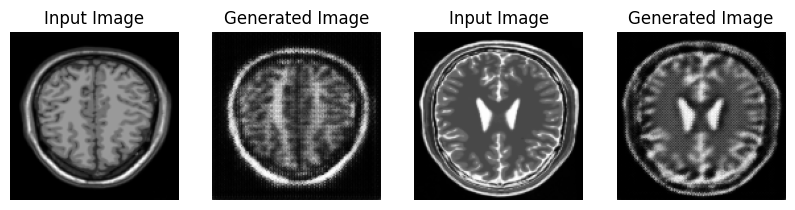

Checkpoint Saving for the epoch run  2 at ./CycleGANmodel/ckpt-2


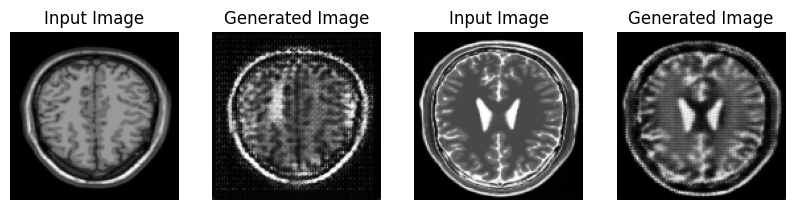

Checkpoint Saving for the epoch run  3 at ./CycleGANmodel/ckpt-3


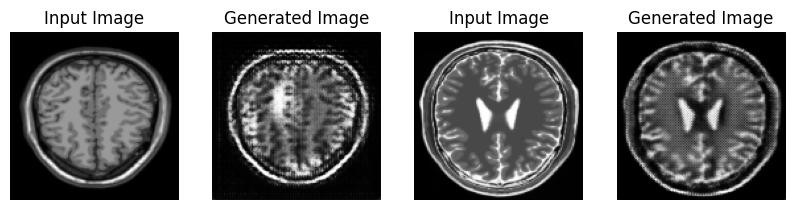

Checkpoint Saving for the epoch run  4 at ./CycleGANmodel/ckpt-4


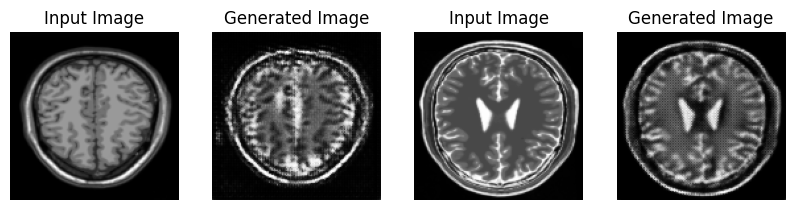

Checkpoint Saving for the epoch run  5 at ./CycleGANmodel/ckpt-5


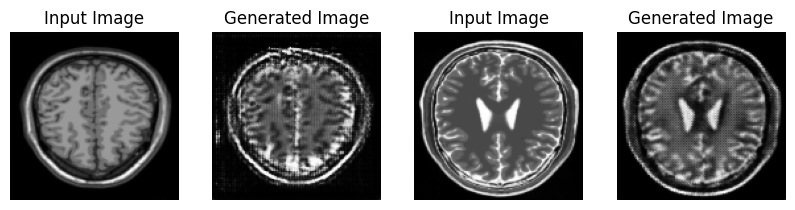

Checkpoint Saving for the epoch run  6 at ./CycleGANmodel/ckpt-6


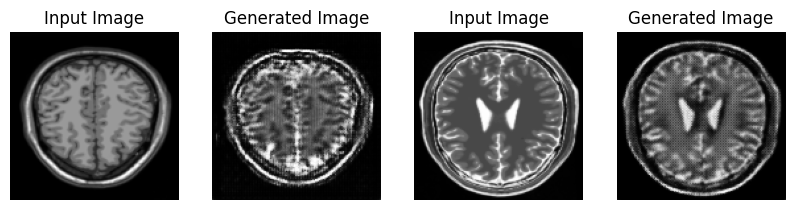

Checkpoint Saving for the epoch run  7 at ./CycleGANmodel/ckpt-7


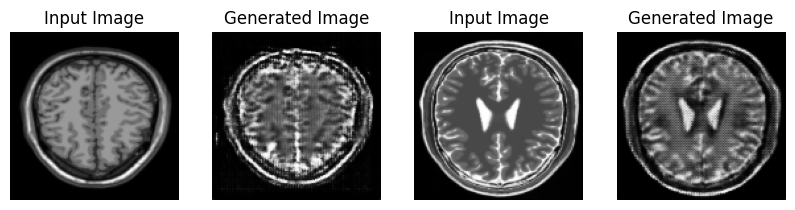

Checkpoint Saving for the epoch run  8 at ./CycleGANmodel/ckpt-8


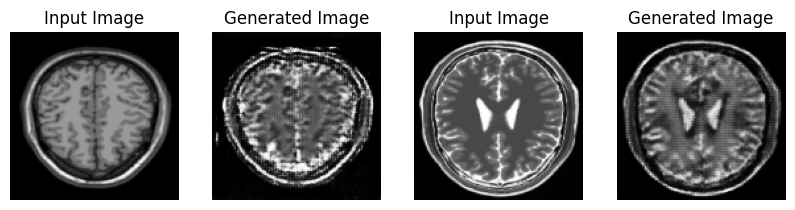

Checkpoint Saving for the epoch run  9 at ./CycleGANmodel/ckpt-9


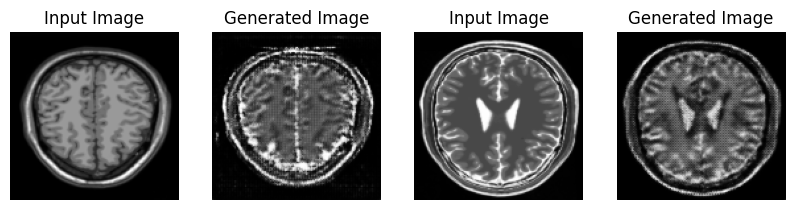

Checkpoint Saving for the epoch run  10 at ./CycleGANmodel/ckpt-10


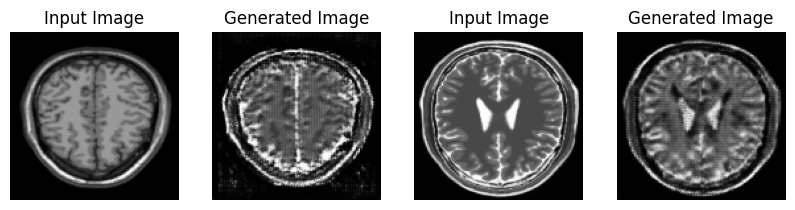

Checkpoint Saving for the epoch run  11 at ./CycleGANmodel/ckpt-11


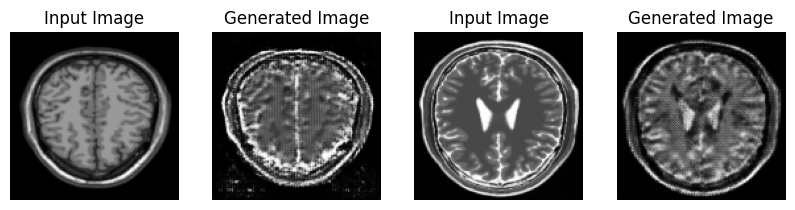

Checkpoint Saving for the epoch run  12 at ./CycleGANmodel/ckpt-12


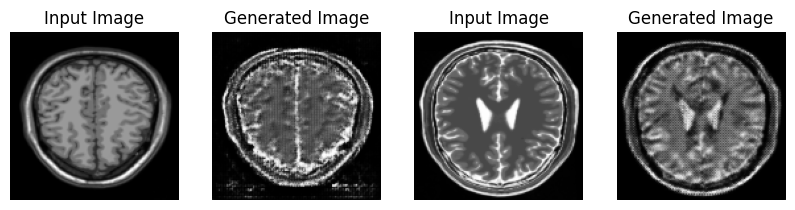

Checkpoint Saving for the epoch run  13 at ./CycleGANmodel/ckpt-13


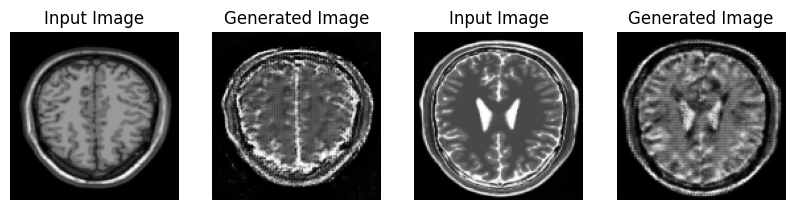

Checkpoint Saving for the epoch run  14 at ./CycleGANmodel/ckpt-14


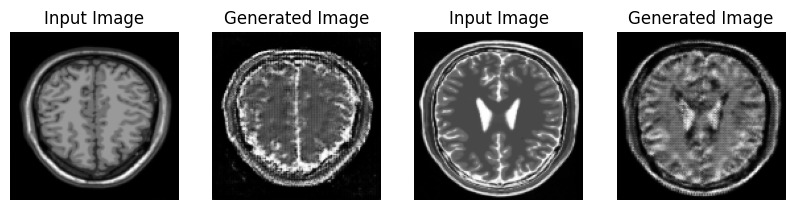

Checkpoint Saving for the epoch run  15 at ./CycleGANmodel/ckpt-15


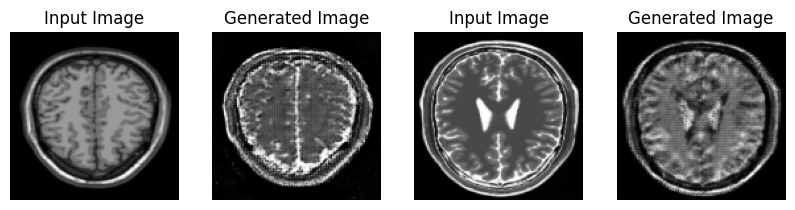

Checkpoint Saving for the epoch run  16 at ./CycleGANmodel/ckpt-16


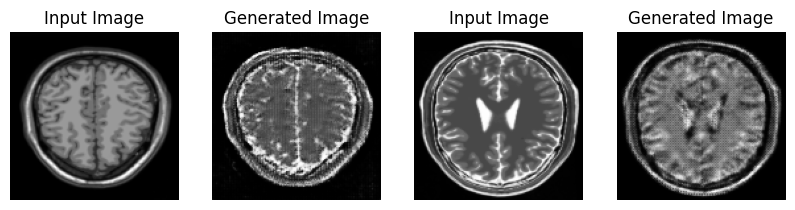

Checkpoint Saving for the epoch run  17 at ./CycleGANmodel/ckpt-17


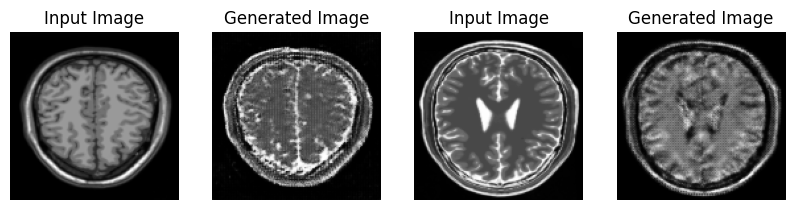

Checkpoint Saving for the epoch run  18 at ./CycleGANmodel/ckpt-18


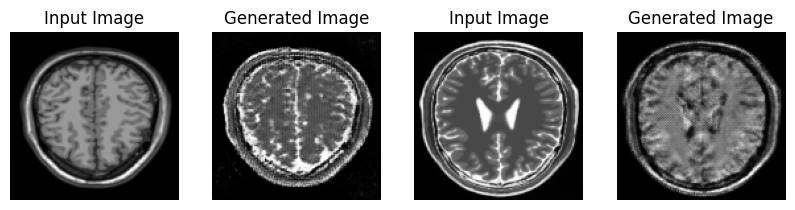

Checkpoint Saving for the epoch run  19 at ./CycleGANmodel/ckpt-19


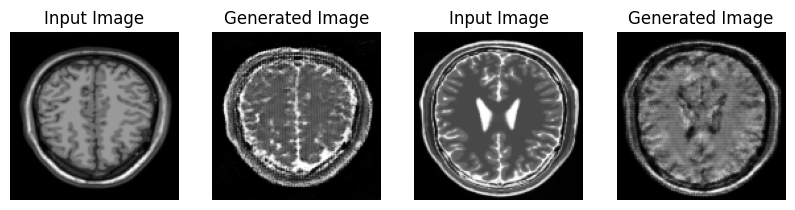

Checkpoint Saving for the epoch run  20 at ./CycleGANmodel/ckpt-20


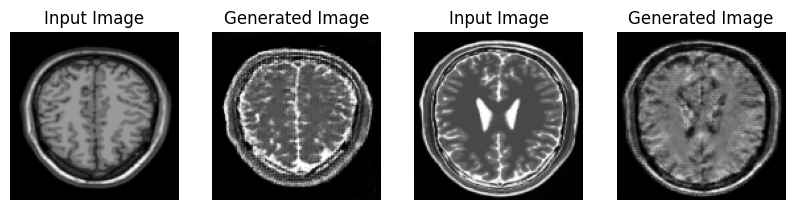

Checkpoint Saving for the epoch run  21 at ./CycleGANmodel/ckpt-21


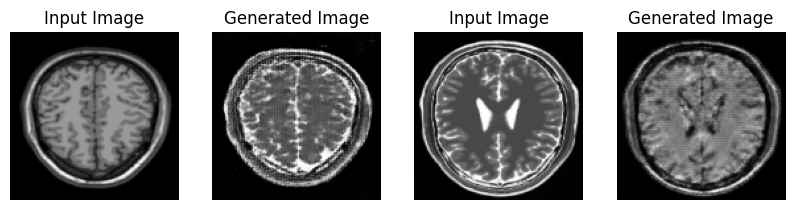

Checkpoint Saving for the epoch run  22 at ./CycleGANmodel/ckpt-22


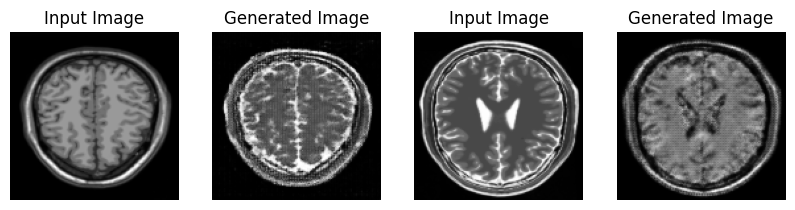

Checkpoint Saving for the epoch run  23 at ./CycleGANmodel/ckpt-23


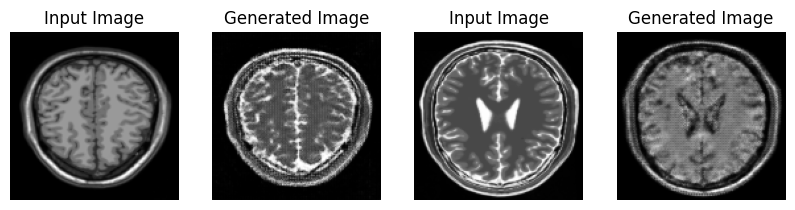

Checkpoint Saving for the epoch run  24 at ./CycleGANmodel/ckpt-24


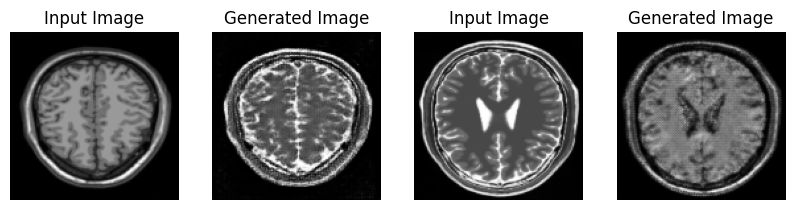

Checkpoint Saving for the epoch run  25 at ./CycleGANmodel/ckpt-25


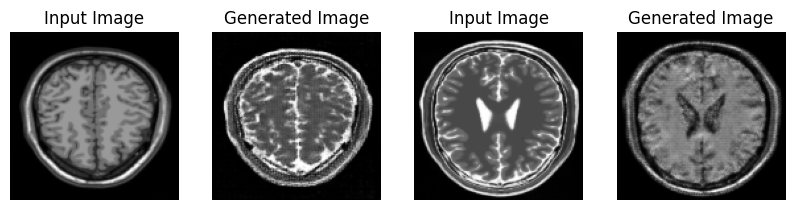

Checkpoint Saving for the epoch run  26 at ./CycleGANmodel/ckpt-26


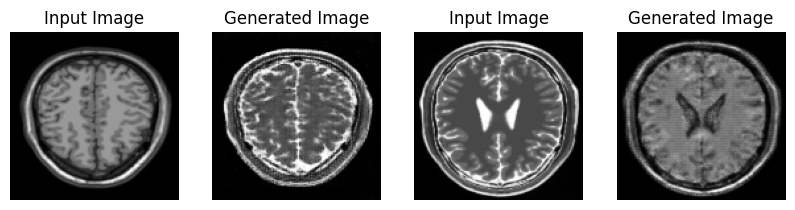

Checkpoint Saving for the epoch run  27 at ./CycleGANmodel/ckpt-27


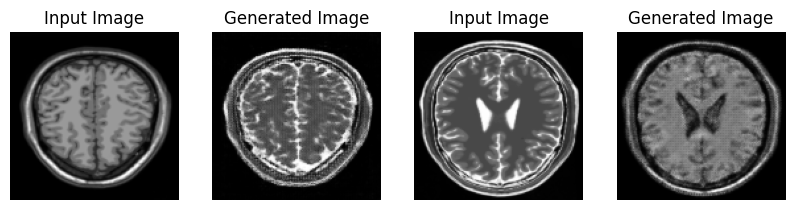

Checkpoint Saving for the epoch run  28 at ./CycleGANmodel/ckpt-28


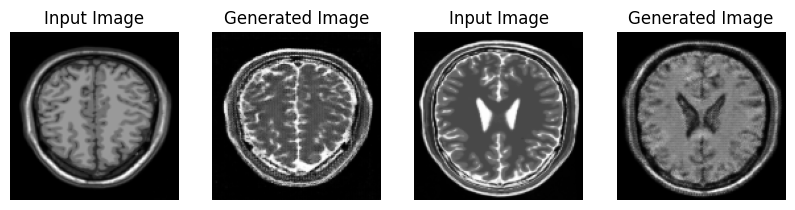

Checkpoint Saving for the epoch run  29 at ./CycleGANmodel/ckpt-29


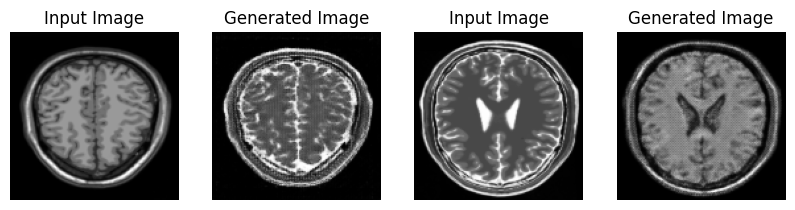

Checkpoint Saving for the epoch run  30 at ./CycleGANmodel/ckpt-30


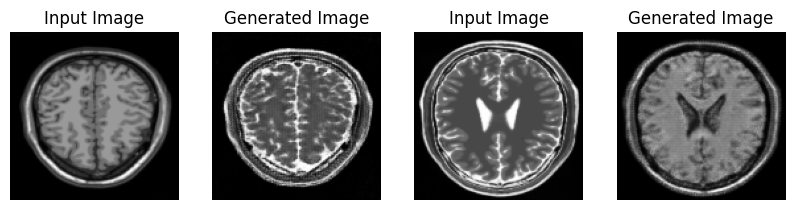

Checkpoint Saving for the epoch run  31 at ./CycleGANmodel/ckpt-31


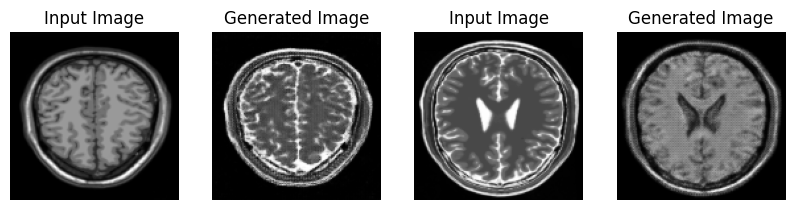

Checkpoint Saving for the epoch run  32 at ./CycleGANmodel/ckpt-32


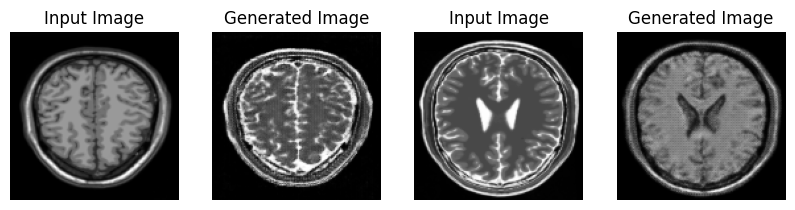

Checkpoint Saving for the epoch run  33 at ./CycleGANmodel/ckpt-33


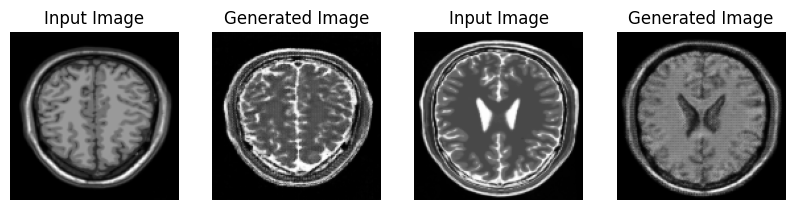

Checkpoint Saving for the epoch run  34 at ./CycleGANmodel/ckpt-34


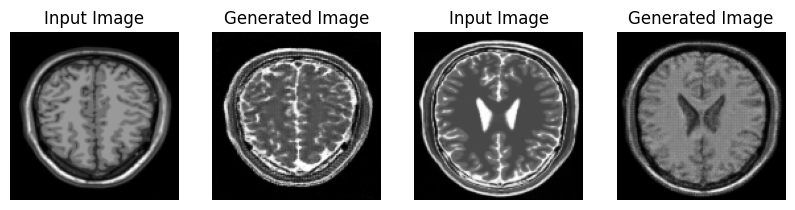

Checkpoint Saving for the epoch run  35 at ./CycleGANmodel/ckpt-35


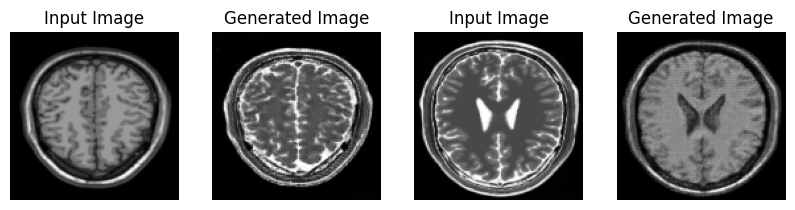

Checkpoint Saving for the epoch run  36 at ./CycleGANmodel/ckpt-36


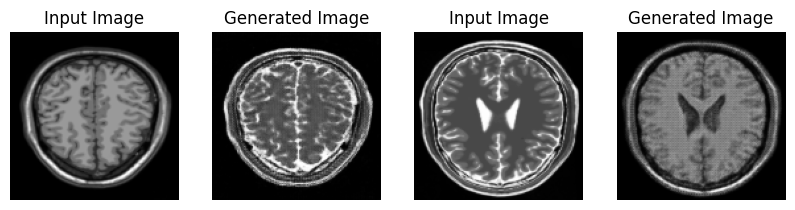

Checkpoint Saving for the epoch run  37 at ./CycleGANmodel/ckpt-37


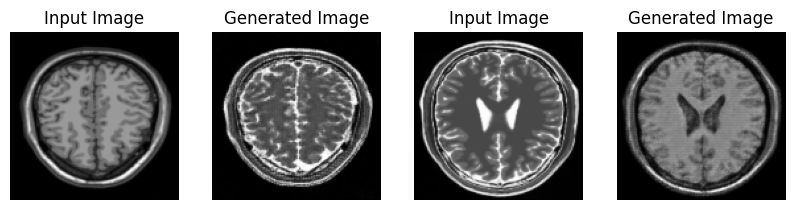

Checkpoint Saving for the epoch run  38 at ./CycleGANmodel/ckpt-38


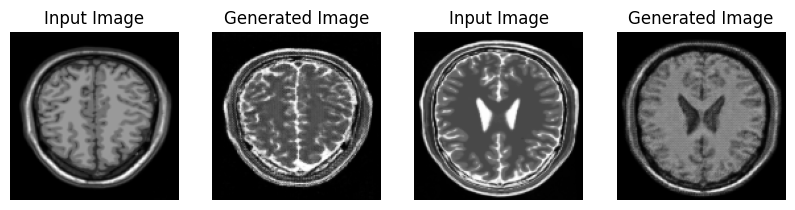

Checkpoint Saving for the epoch run  39 at ./CycleGANmodel/ckpt-39


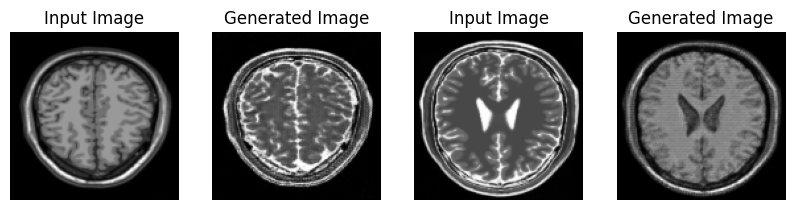

Checkpoint Saving for the epoch run  40 at ./CycleGANmodel/ckpt-40


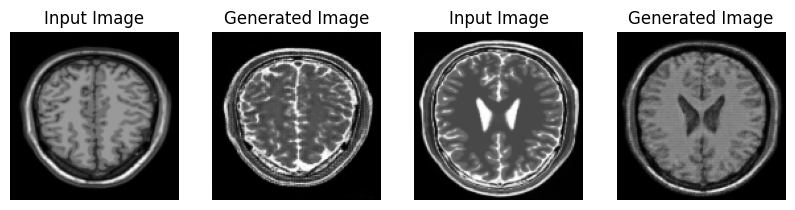

Checkpoint Saving for the epoch run  41 at ./CycleGANmodel/ckpt-41


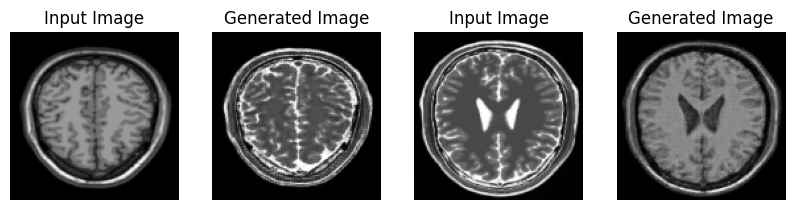

Checkpoint Saving for the epoch run  42 at ./CycleGANmodel/ckpt-42


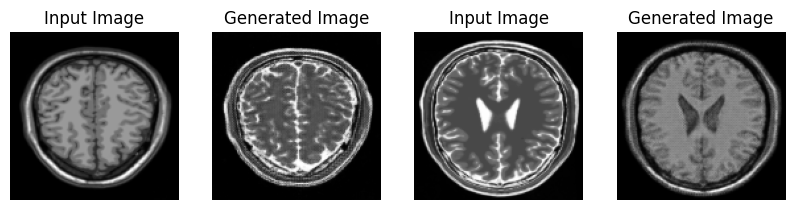

Checkpoint Saving for the epoch run  43 at ./CycleGANmodel/ckpt-43


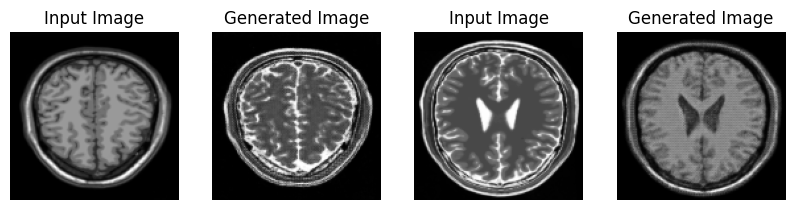

Checkpoint Saving for the epoch run  44 at ./CycleGANmodel/ckpt-44


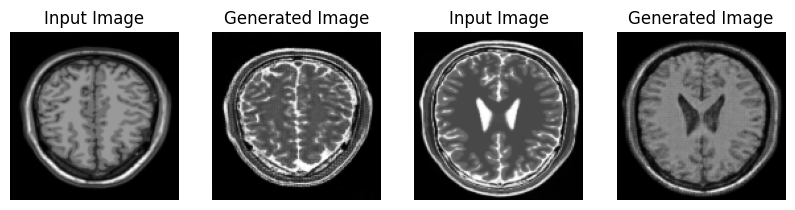

Checkpoint Saving for the epoch run  45 at ./CycleGANmodel/ckpt-45


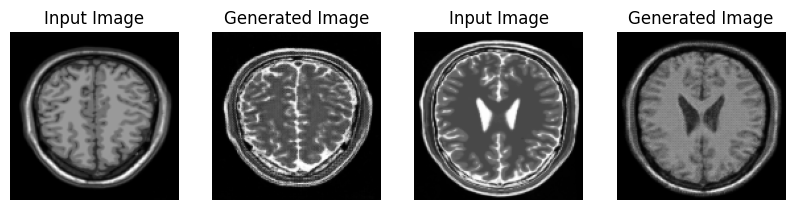

Checkpoint Saving for the epoch run  46 at ./CycleGANmodel/ckpt-46


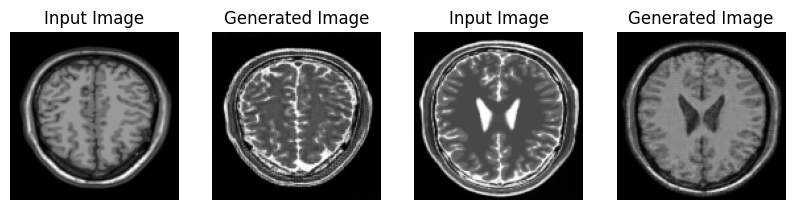

Checkpoint Saving for the epoch run  47 at ./CycleGANmodel/ckpt-47


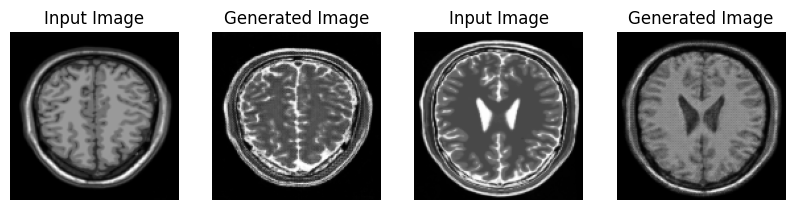

Checkpoint Saving for the epoch run  48 at ./CycleGANmodel/ckpt-48


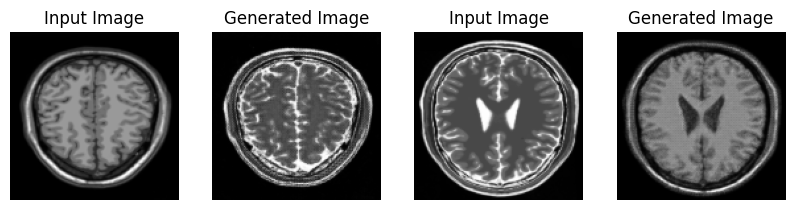

Checkpoint Saving for the epoch run  49 at ./CycleGANmodel/ckpt-49


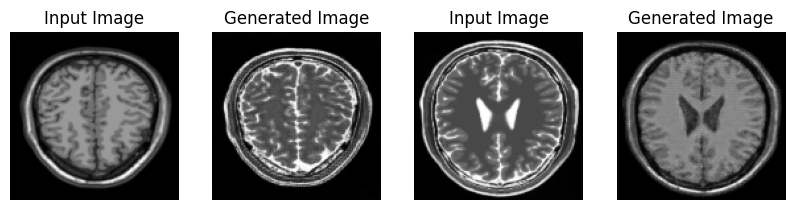

Checkpoint Saving for the epoch run  50 at ./CycleGANmodel/ckpt-50


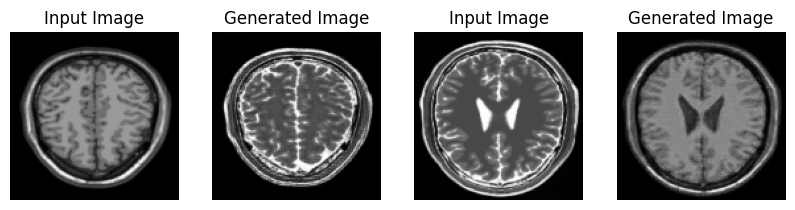

Checkpoint Saving for the epoch run  51 at ./CycleGANmodel/ckpt-51


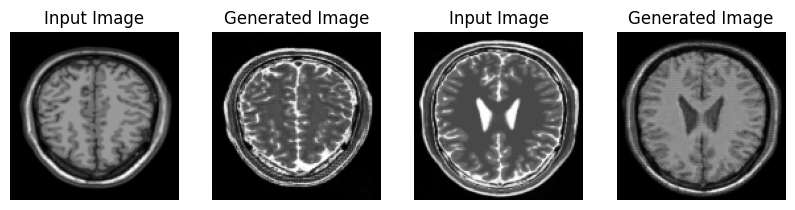

Checkpoint Saving for the epoch run  52 at ./CycleGANmodel/ckpt-52


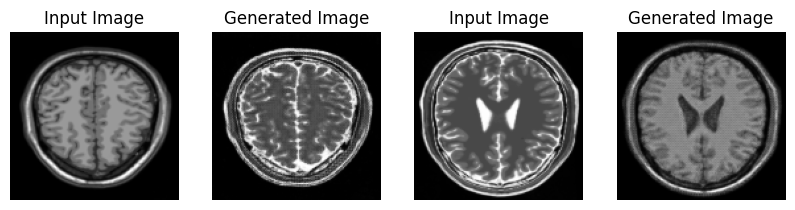

Checkpoint Saving for the epoch run  53 at ./CycleGANmodel/ckpt-53


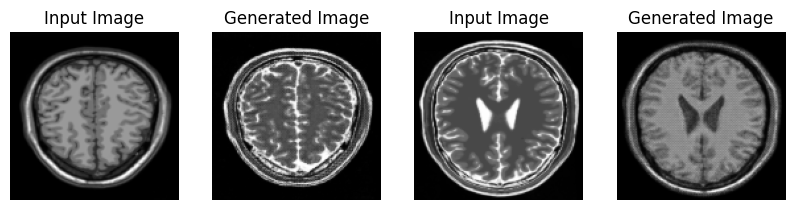

Checkpoint Saving for the epoch run  54 at ./CycleGANmodel/ckpt-54


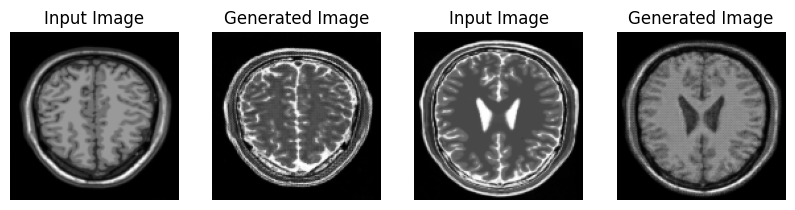

Checkpoint Saving for the epoch run  55 at ./CycleGANmodel/ckpt-55


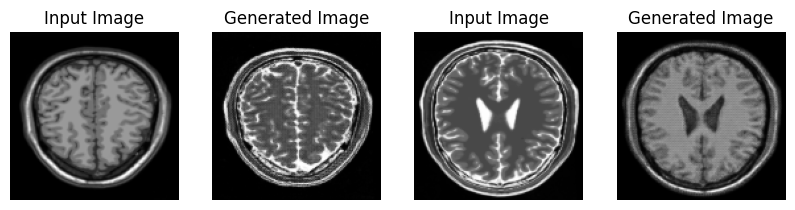

Checkpoint Saving for the epoch run  56 at ./CycleGANmodel/ckpt-56


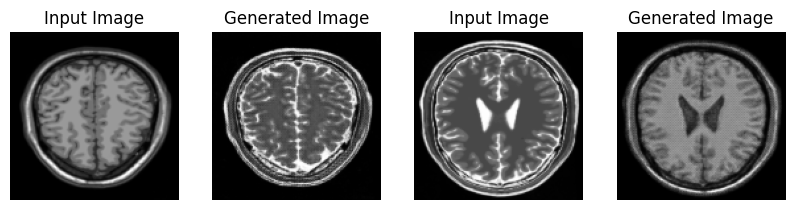

Checkpoint Saving for the epoch run  57 at ./CycleGANmodel/ckpt-57


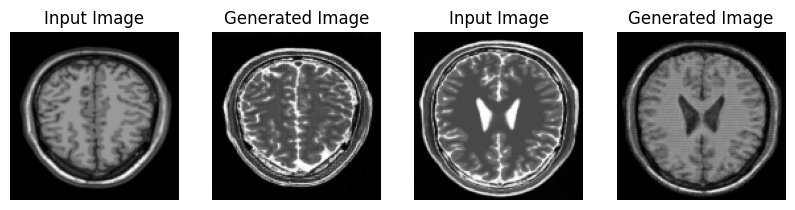

Checkpoint Saving for the epoch run  58 at ./CycleGANmodel/ckpt-58


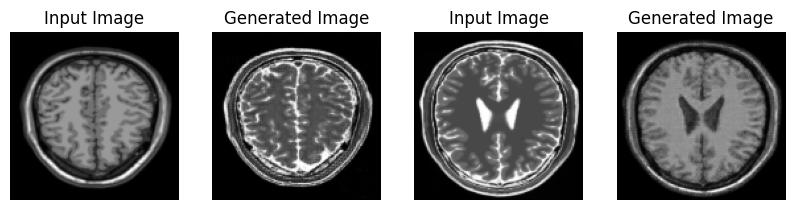

Checkpoint Saving for the epoch run  59 at ./CycleGANmodel/ckpt-59


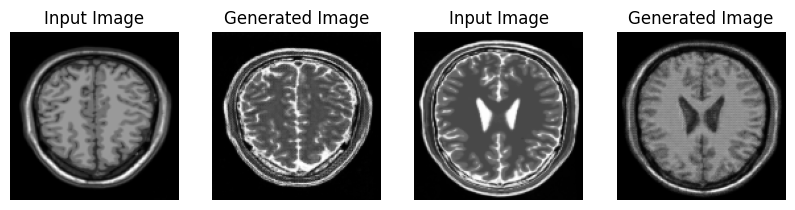

Checkpoint Saving for the epoch run  60 at ./CycleGANmodel/ckpt-60


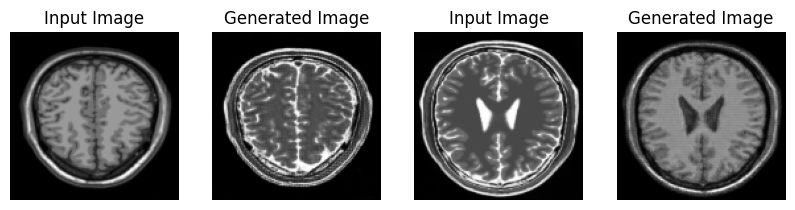

Checkpoint Saving for the epoch run  61 at ./CycleGANmodel/ckpt-61


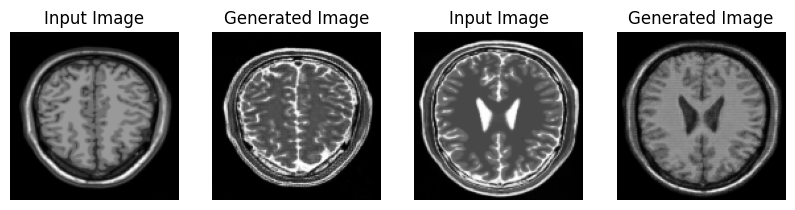

Checkpoint Saving for the epoch run  62 at ./CycleGANmodel/ckpt-62


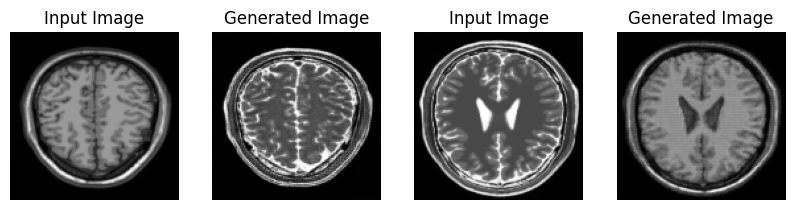

Checkpoint Saving for the epoch run  63 at ./CycleGANmodel/ckpt-63


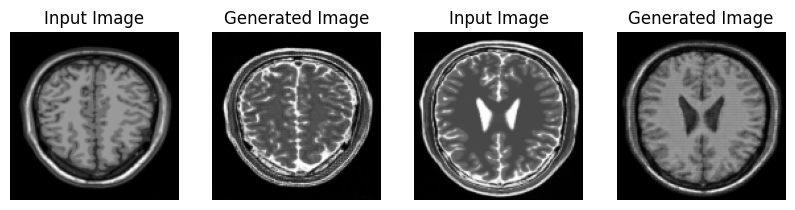

Checkpoint Saving for the epoch run  64 at ./CycleGANmodel/ckpt-64


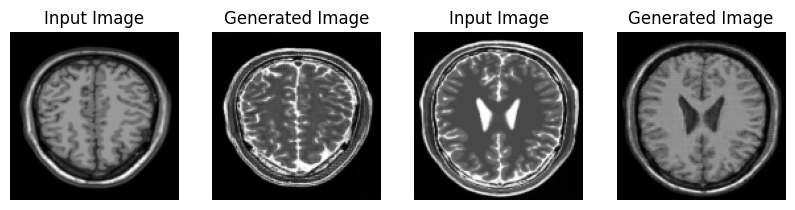

Checkpoint Saving for the epoch run  65 at ./CycleGANmodel/ckpt-65


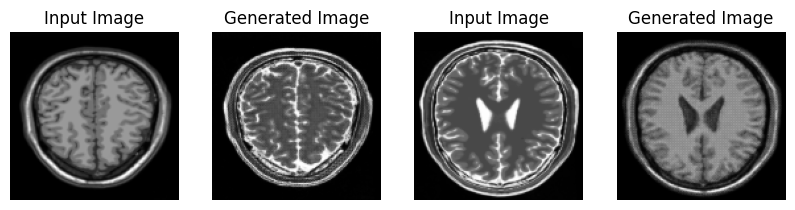

Checkpoint Saving for the epoch run  66 at ./CycleGANmodel/ckpt-66


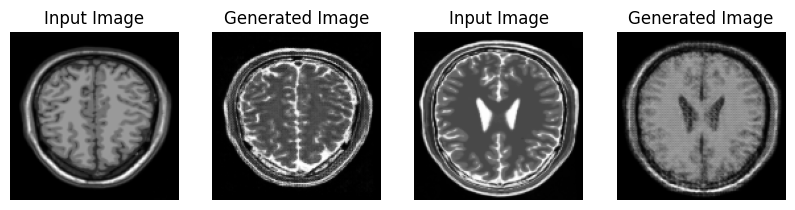

Checkpoint Saving for the epoch run  67 at ./CycleGANmodel/ckpt-67


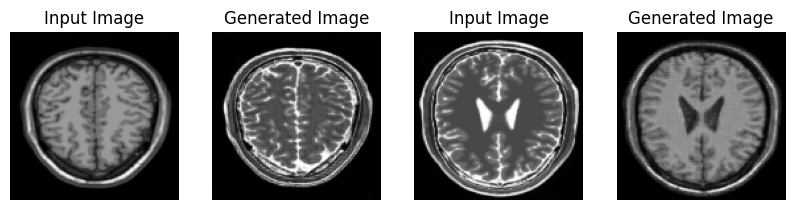

Checkpoint Saving for the epoch run  68 at ./CycleGANmodel/ckpt-68


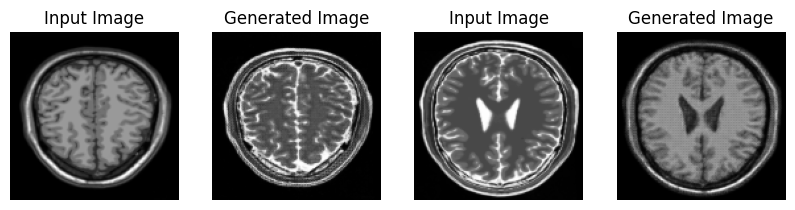

Checkpoint Saving for the epoch run  69 at ./CycleGANmodel/ckpt-69


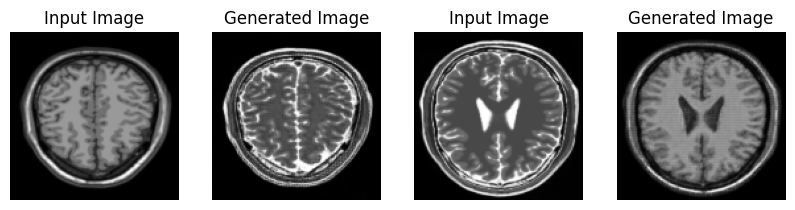

Checkpoint Saving for the epoch run  70 at ./CycleGANmodel/ckpt-70


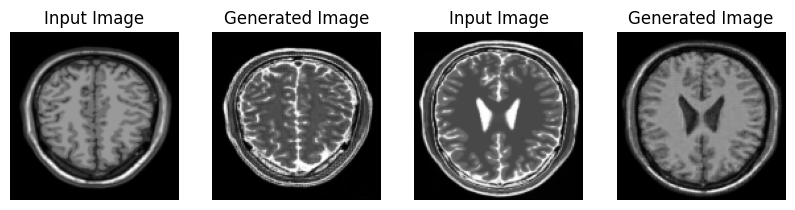

Checkpoint Saving for the epoch run  71 at ./CycleGANmodel/ckpt-71


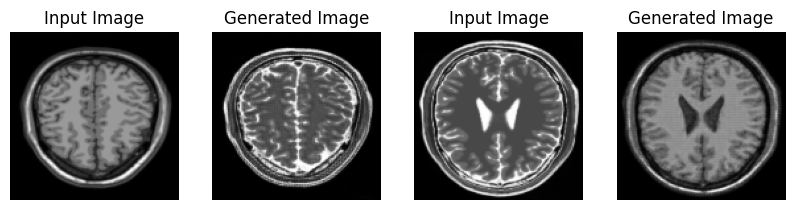

Checkpoint Saving for the epoch run  72 at ./CycleGANmodel/ckpt-72


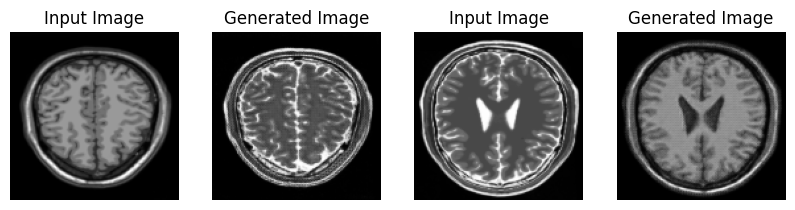

Checkpoint Saving for the epoch run  73 at ./CycleGANmodel/ckpt-73


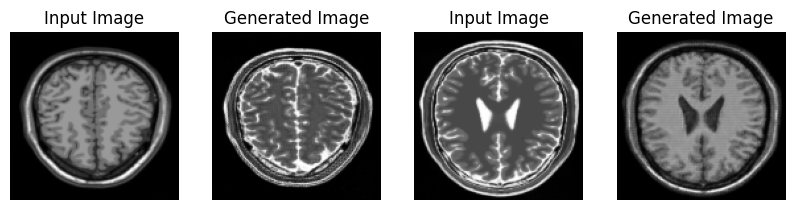

Checkpoint Saving for the epoch run  74 at ./CycleGANmodel/ckpt-74


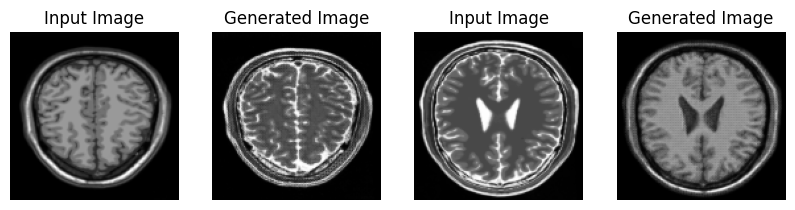

Checkpoint Saving for the epoch run  75 at ./CycleGANmodel/ckpt-75


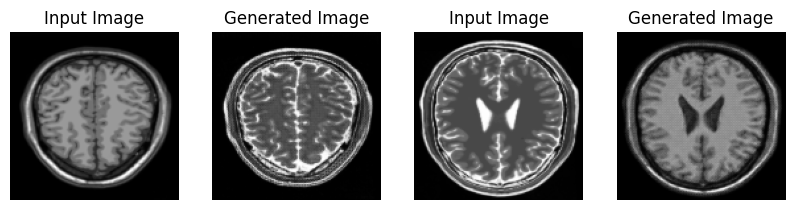

Checkpoint Saving for the epoch run  76 at ./CycleGANmodel/ckpt-76


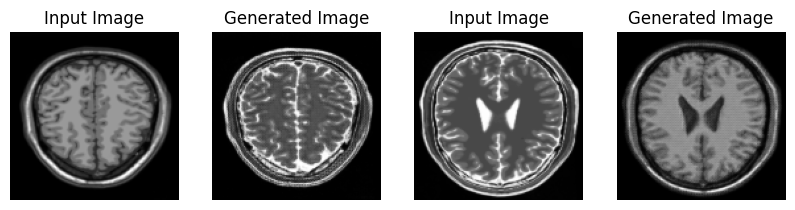

Checkpoint Saving for the epoch run  77 at ./CycleGANmodel/ckpt-77


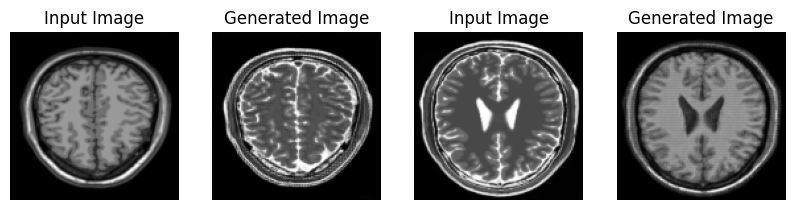

Checkpoint Saving for the epoch run  78 at ./CycleGANmodel/ckpt-78


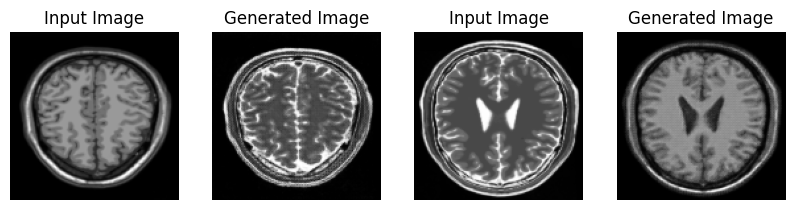

Checkpoint Saving for the epoch run  79 at ./CycleGANmodel/ckpt-79


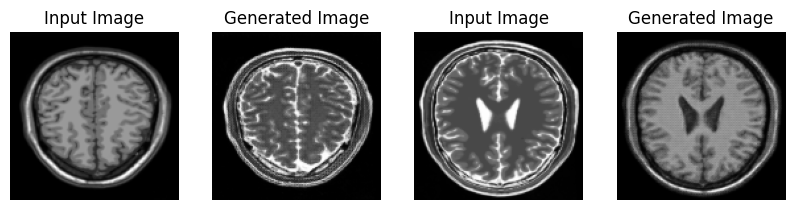

Checkpoint Saving for the epoch run  80 at ./CycleGANmodel/ckpt-80


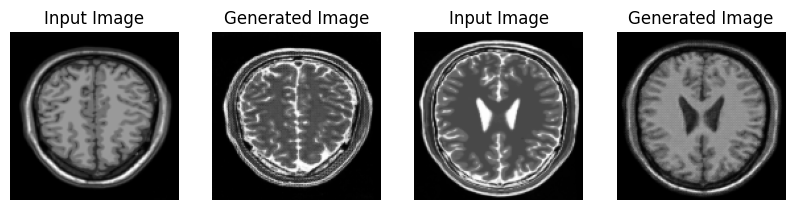

Checkpoint Saving for the epoch run  81 at ./CycleGANmodel/ckpt-81


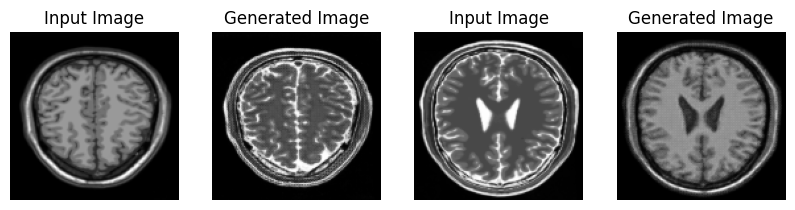

Checkpoint Saving for the epoch run  82 at ./CycleGANmodel/ckpt-82


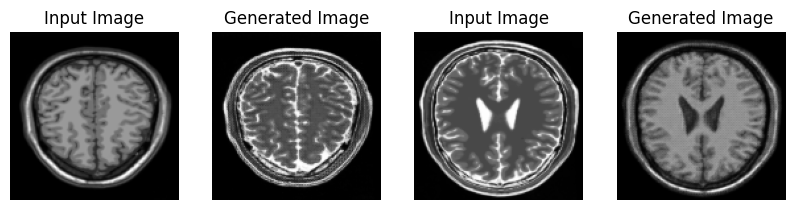

Checkpoint Saving for the epoch run  83 at ./CycleGANmodel/ckpt-83


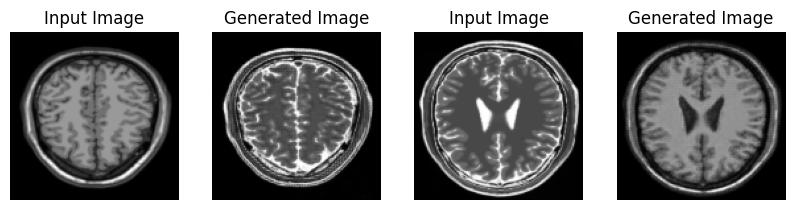

Checkpoint Saving for the epoch run  84 at ./CycleGANmodel/ckpt-84


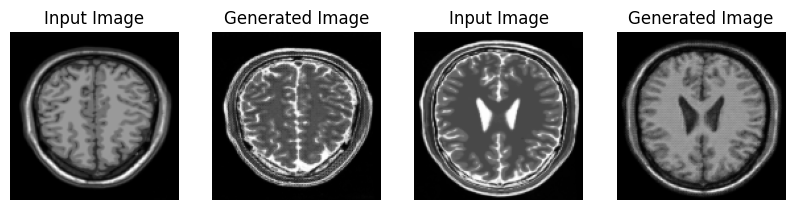

Checkpoint Saving for the epoch run  85 at ./CycleGANmodel/ckpt-85


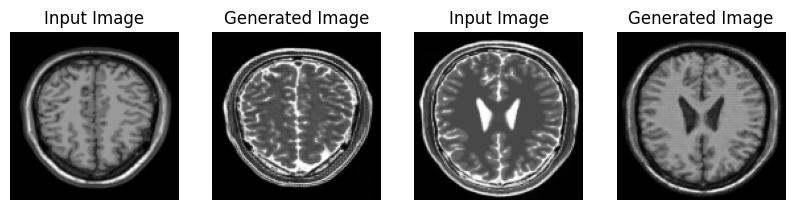

Checkpoint Saving for the epoch run  86 at ./CycleGANmodel/ckpt-86


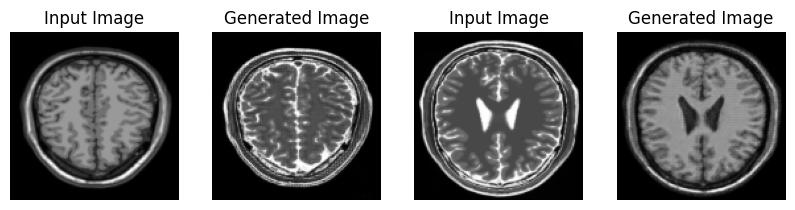

Checkpoint Saving for the epoch run  87 at ./CycleGANmodel/ckpt-87


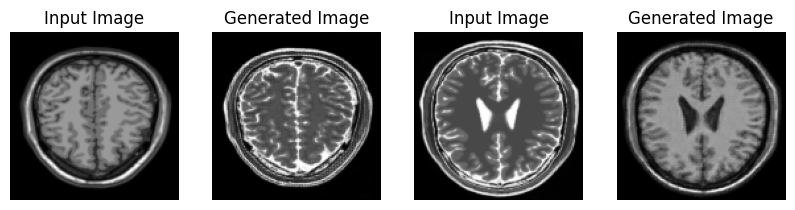

Checkpoint Saving for the epoch run  88 at ./CycleGANmodel/ckpt-88


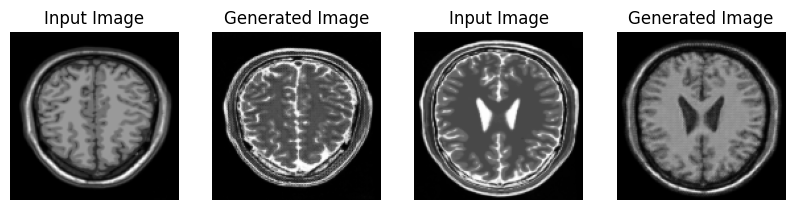

Checkpoint Saving for the epoch run  89 at ./CycleGANmodel/ckpt-89


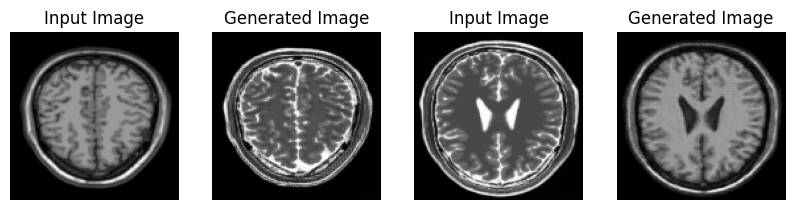

Checkpoint Saving for the epoch run  90 at ./CycleGANmodel/ckpt-90


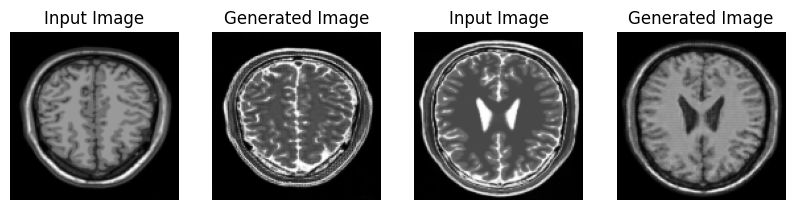

Checkpoint Saving for the epoch run  91 at ./CycleGANmodel/ckpt-91


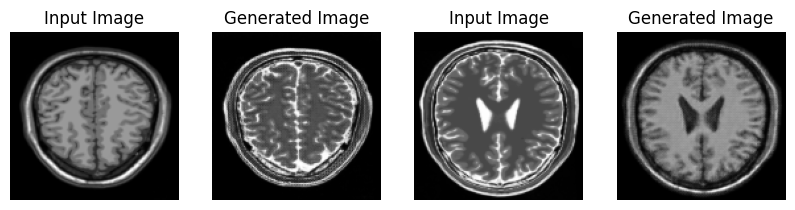

Checkpoint Saving for the epoch run  92 at ./CycleGANmodel/ckpt-92


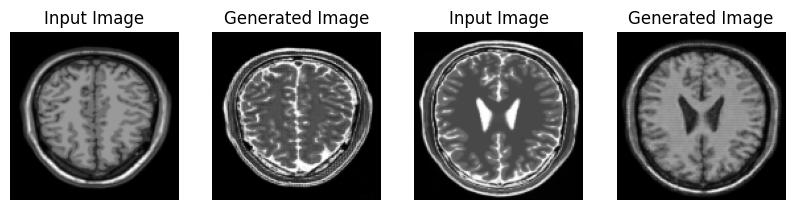

Checkpoint Saving for the epoch run  93 at ./CycleGANmodel/ckpt-93


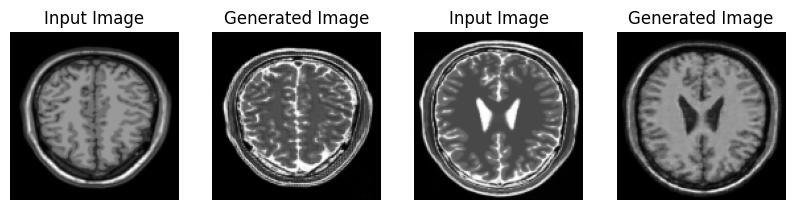

Checkpoint Saving for the epoch run  94 at ./CycleGANmodel/ckpt-94


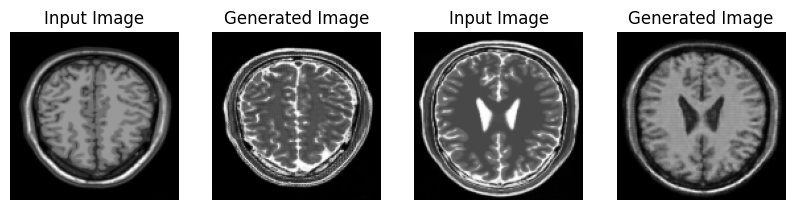

Checkpoint Saving for the epoch run  95 at ./CycleGANmodel/ckpt-95


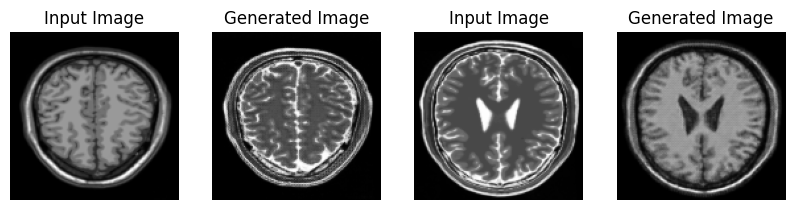

Checkpoint Saving for the epoch run  96 at ./CycleGANmodel/ckpt-96


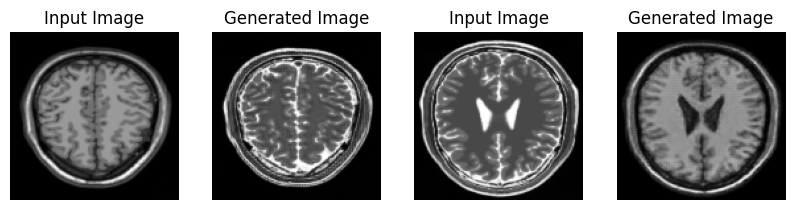

Checkpoint Saving for the epoch run  97 at ./CycleGANmodel/ckpt-97


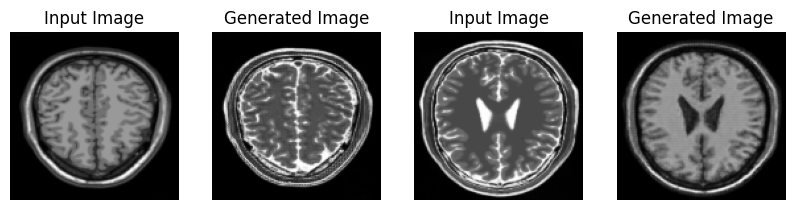

Checkpoint Saving for the epoch run  98 at ./CycleGANmodel/ckpt-98


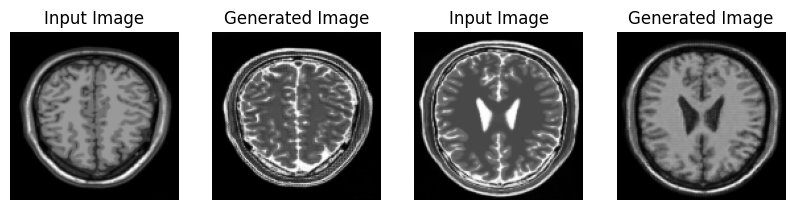

Checkpoint Saving for the epoch run  99 at ./CycleGANmodel/ckpt-99


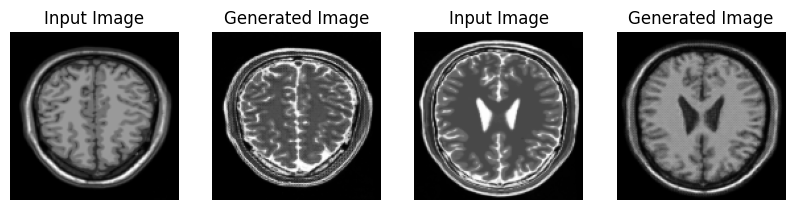

Checkpoint Saving for the epoch run  100 at ./CycleGANmodel/ckpt-100


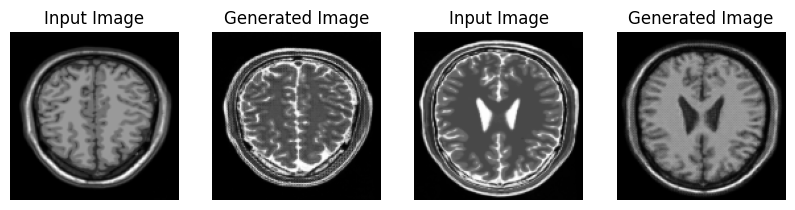

Checkpoint Saving for the epoch run  101 at ./CycleGANmodel/ckpt-101


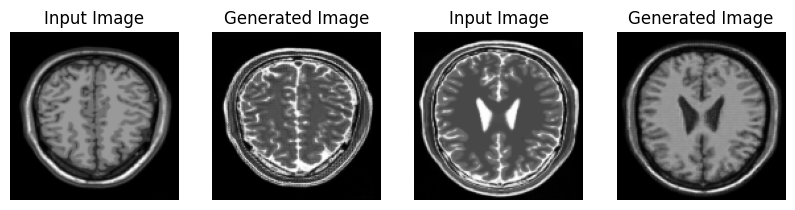

Checkpoint Saving for the epoch run  102 at ./CycleGANmodel/ckpt-102


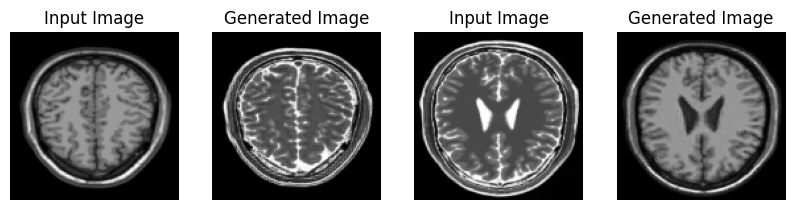

Checkpoint Saving for the epoch run  103 at ./CycleGANmodel/ckpt-103


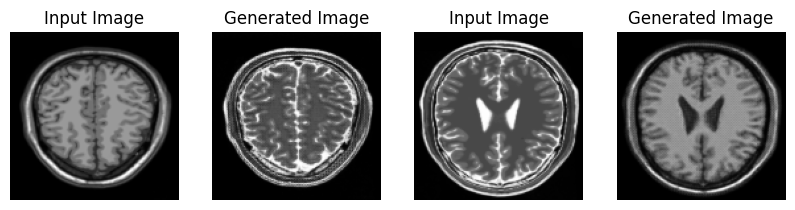

Checkpoint Saving for the epoch run  104 at ./CycleGANmodel/ckpt-104


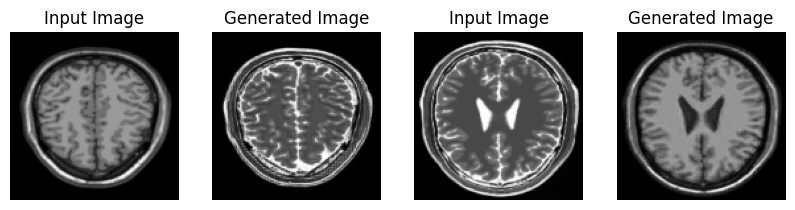

Checkpoint Saving for the epoch run  105 at ./CycleGANmodel/ckpt-105


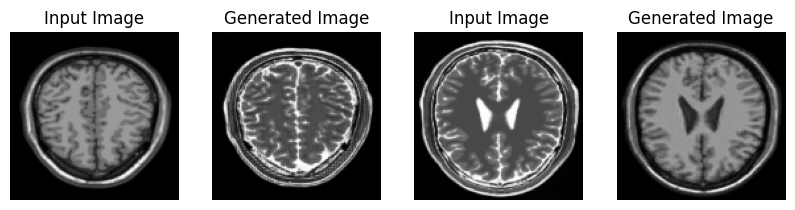

Checkpoint Saving for the epoch run  106 at ./CycleGANmodel/ckpt-106


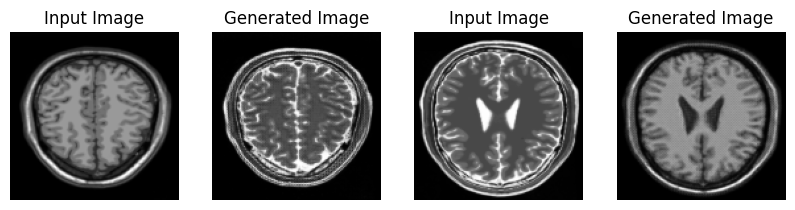

Checkpoint Saving for the epoch run  107 at ./CycleGANmodel/ckpt-107


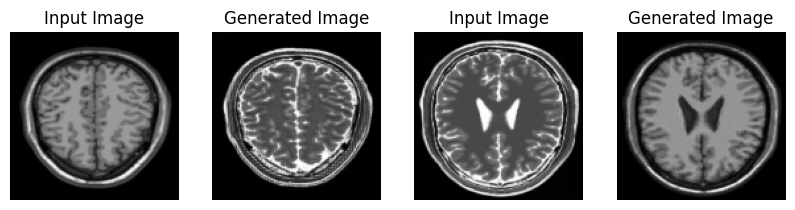

Checkpoint Saving for the epoch run  108 at ./CycleGANmodel/ckpt-108


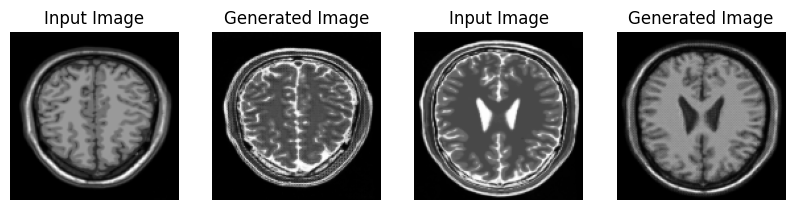

Checkpoint Saving for the epoch run  109 at ./CycleGANmodel/ckpt-109


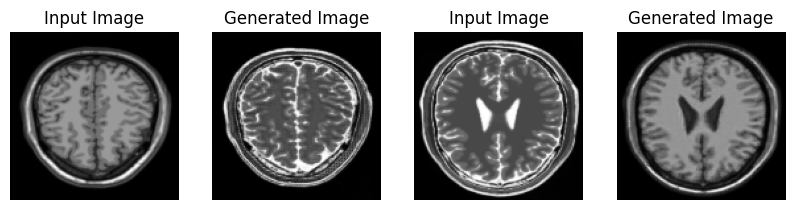

Checkpoint Saving for the epoch run  110 at ./CycleGANmodel/ckpt-110


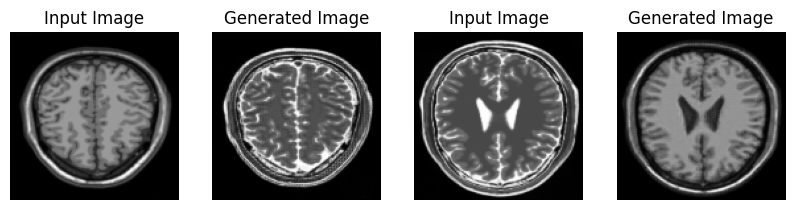

Checkpoint Saving for the epoch run  111 at ./CycleGANmodel/ckpt-111


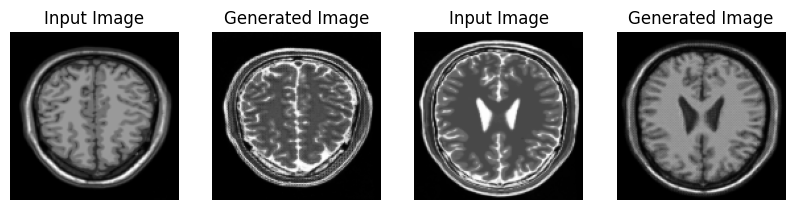

Checkpoint Saving for the epoch run  112 at ./CycleGANmodel/ckpt-112


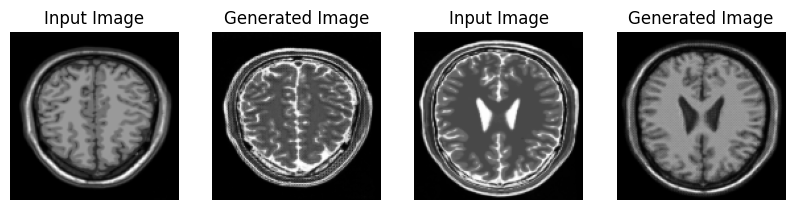

Checkpoint Saving for the epoch run  113 at ./CycleGANmodel/ckpt-113


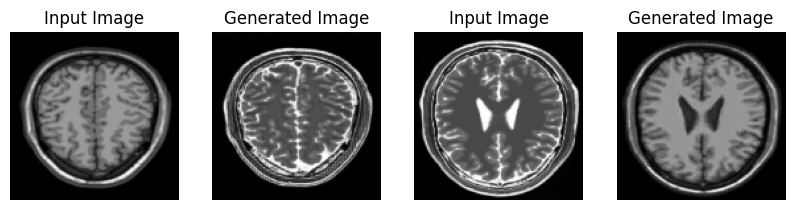

Checkpoint Saving for the epoch run  114 at ./CycleGANmodel/ckpt-114


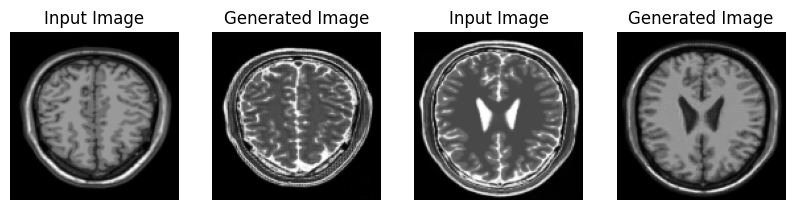

Checkpoint Saving for the epoch run  115 at ./CycleGANmodel/ckpt-115


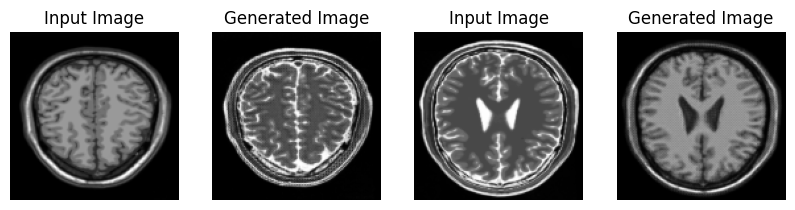

Checkpoint Saving for the epoch run  116 at ./CycleGANmodel/ckpt-116


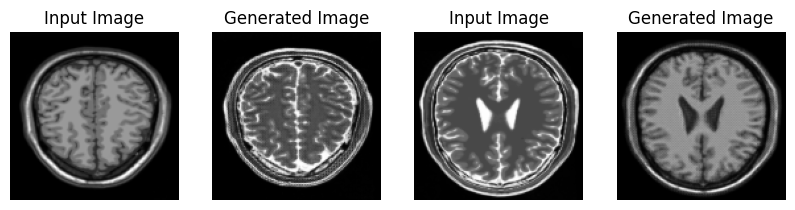

Checkpoint Saving for the epoch run  117 at ./CycleGANmodel/ckpt-117


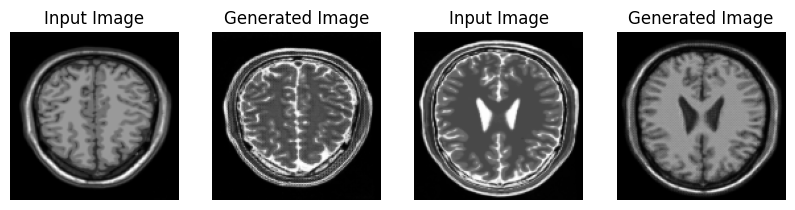

Checkpoint Saving for the epoch run  118 at ./CycleGANmodel/ckpt-118


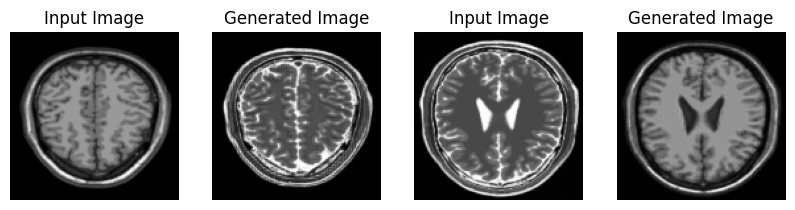

Checkpoint Saving for the epoch run  119 at ./CycleGANmodel/ckpt-119


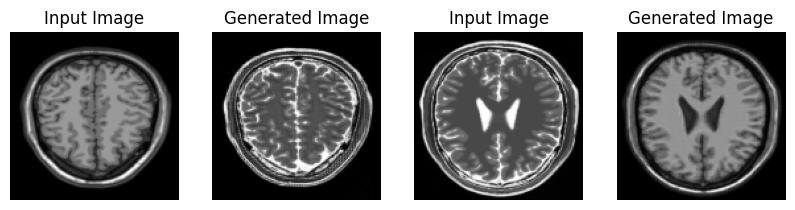

Checkpoint Saving for the epoch run  120 at ./CycleGANmodel/ckpt-120


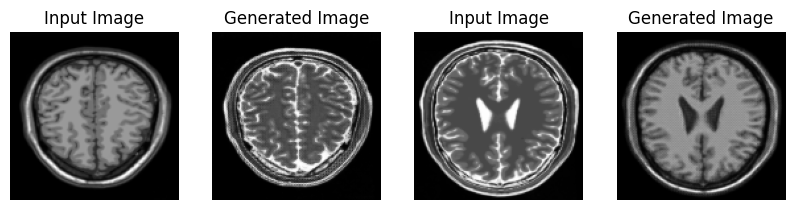

Checkpoint Saving for the epoch run  121 at ./CycleGANmodel/ckpt-121


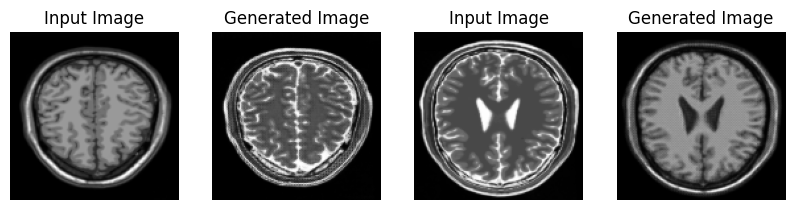

Checkpoint Saving for the epoch run  122 at ./CycleGANmodel/ckpt-122


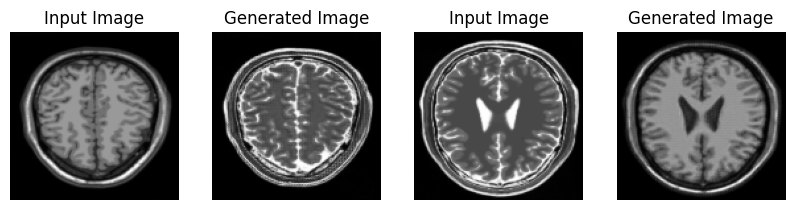

Checkpoint Saving for the epoch run  123 at ./CycleGANmodel/ckpt-123


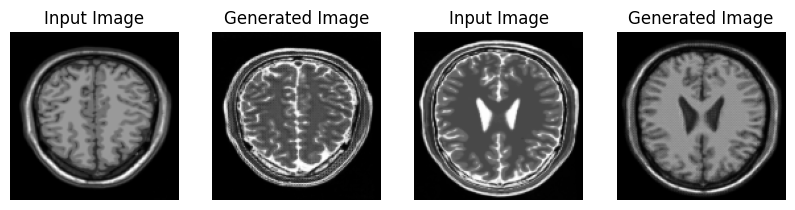

Checkpoint Saving for the epoch run  124 at ./CycleGANmodel/ckpt-124


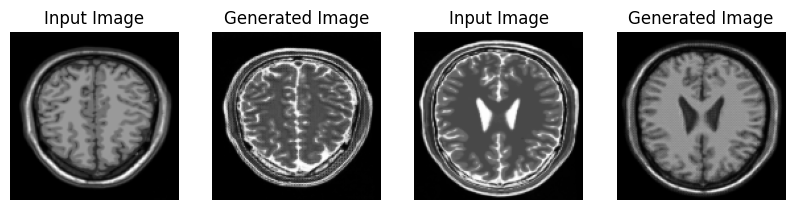

Checkpoint Saving for the epoch run  125 at ./CycleGANmodel/ckpt-125


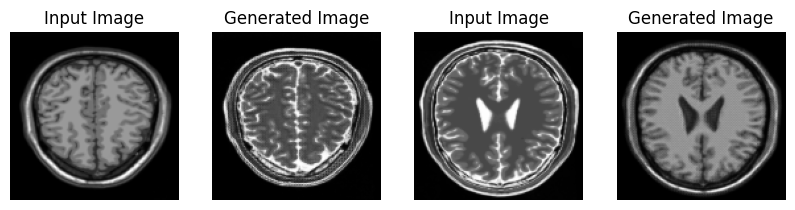

Checkpoint Saving for the epoch run  126 at ./CycleGANmodel/ckpt-126


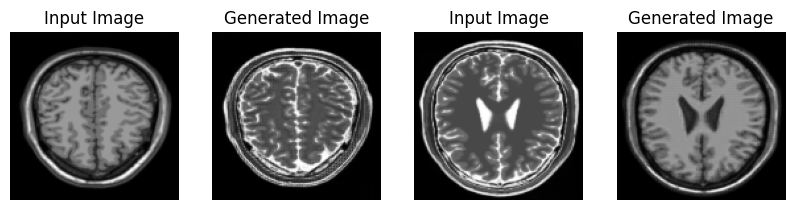

Checkpoint Saving for the epoch run  127 at ./CycleGANmodel/ckpt-127


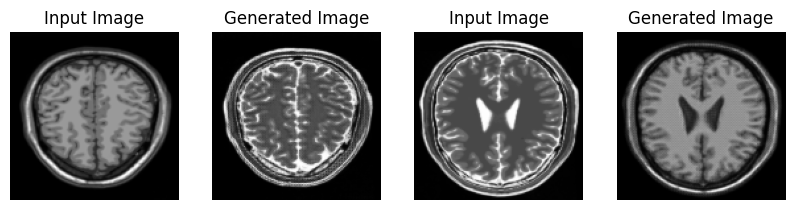

Checkpoint Saving for the epoch run  128 at ./CycleGANmodel/ckpt-128


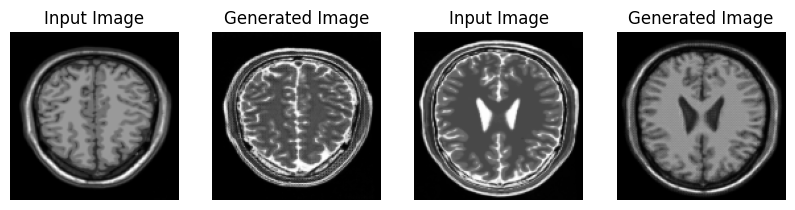

Checkpoint Saving for the epoch run  129 at ./CycleGANmodel/ckpt-129


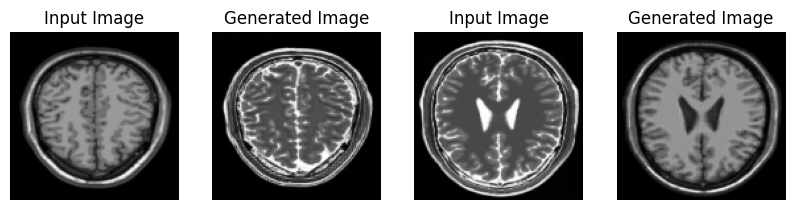

Checkpoint Saving for the epoch run  130 at ./CycleGANmodel/ckpt-130


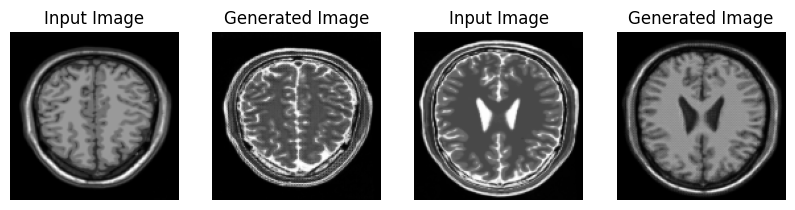

Checkpoint Saving for the epoch run  131 at ./CycleGANmodel/ckpt-131


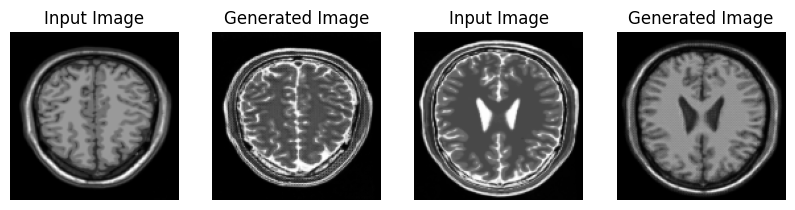

Checkpoint Saving for the epoch run  132 at ./CycleGANmodel/ckpt-132


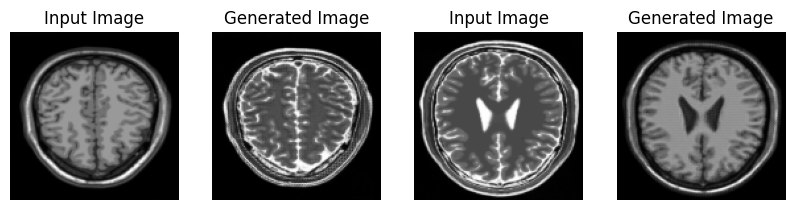

Checkpoint Saving for the epoch run  133 at ./CycleGANmodel/ckpt-133


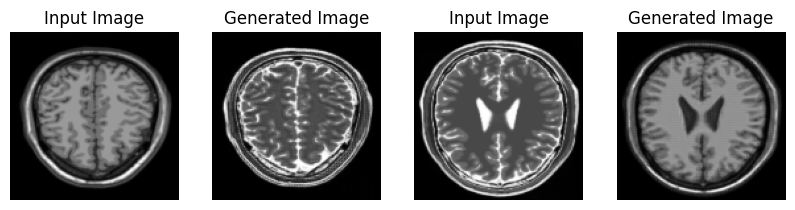

Checkpoint Saving for the epoch run  134 at ./CycleGANmodel/ckpt-134


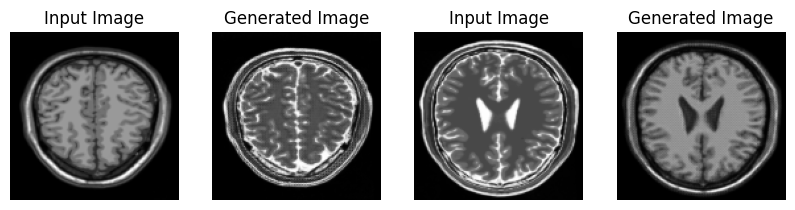

Checkpoint Saving for the epoch run  135 at ./CycleGANmodel/ckpt-135


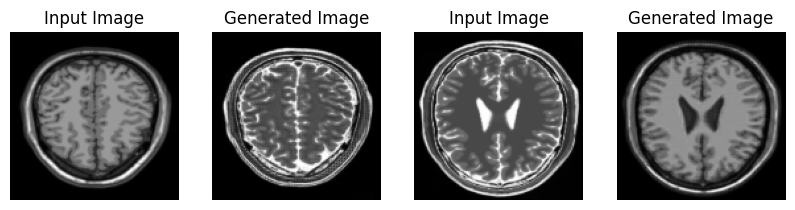

Checkpoint Saving for the epoch run  136 at ./CycleGANmodel/ckpt-136


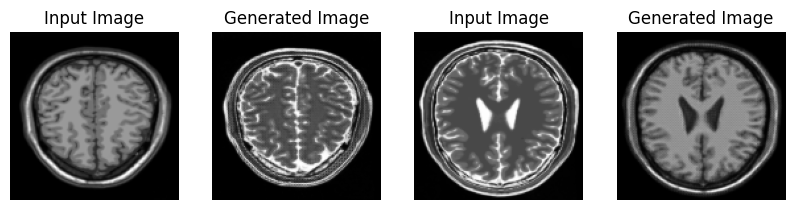

Checkpoint Saving for the epoch run  137 at ./CycleGANmodel/ckpt-137


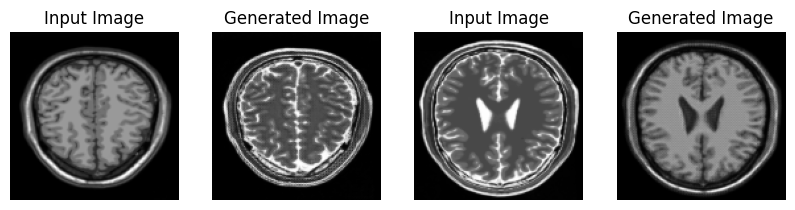

Checkpoint Saving for the epoch run  138 at ./CycleGANmodel/ckpt-138


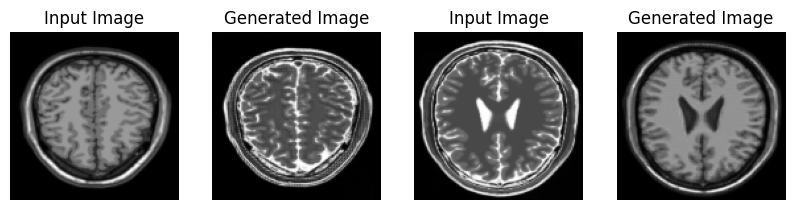

Checkpoint Saving for the epoch run  139 at ./CycleGANmodel/ckpt-139


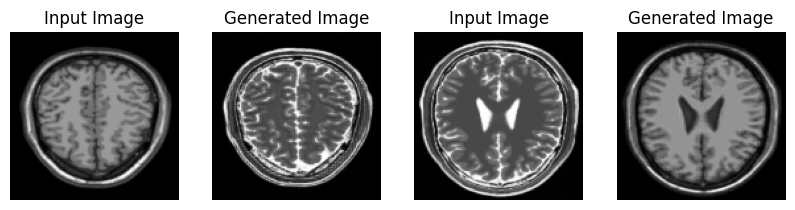

Checkpoint Saving for the epoch run  140 at ./CycleGANmodel/ckpt-140


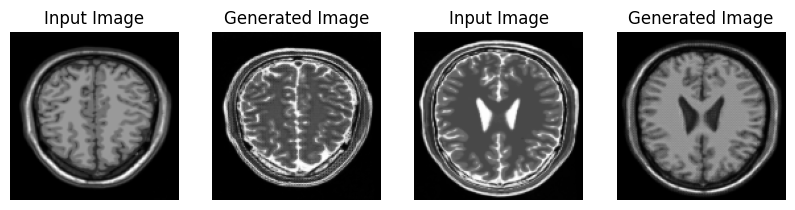

Checkpoint Saving for the epoch run  141 at ./CycleGANmodel/ckpt-141


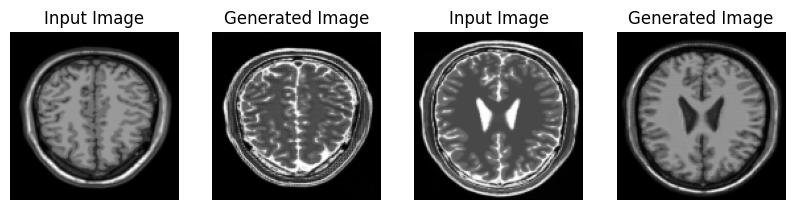

Checkpoint Saving for the epoch run  142 at ./CycleGANmodel/ckpt-142


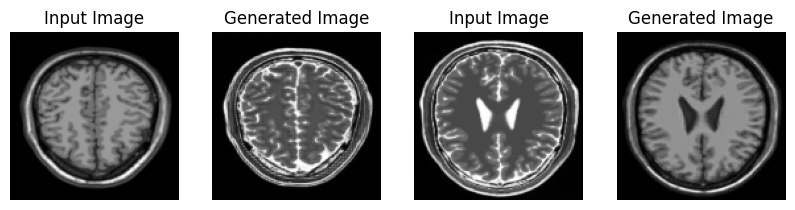

Checkpoint Saving for the epoch run  143 at ./CycleGANmodel/ckpt-143


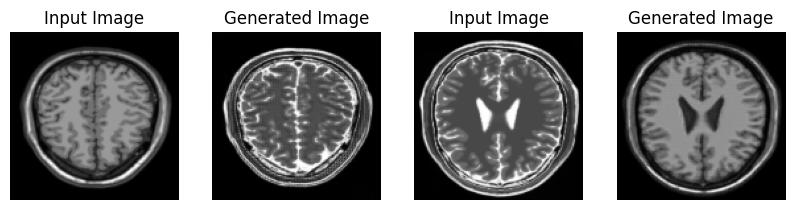

Checkpoint Saving for the epoch run  144 at ./CycleGANmodel/ckpt-144


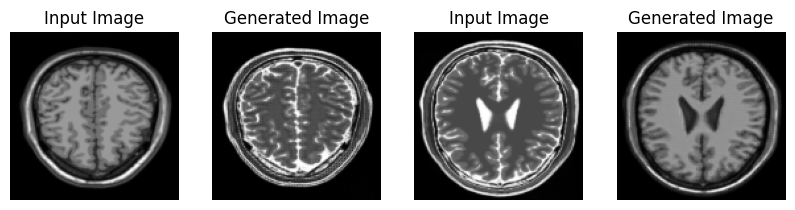

Checkpoint Saving for the epoch run  145 at ./CycleGANmodel/ckpt-145


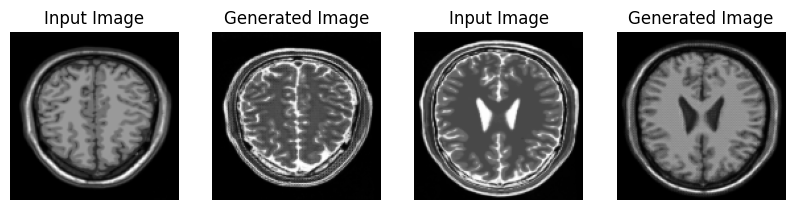

Checkpoint Saving for the epoch run  146 at ./CycleGANmodel/ckpt-146


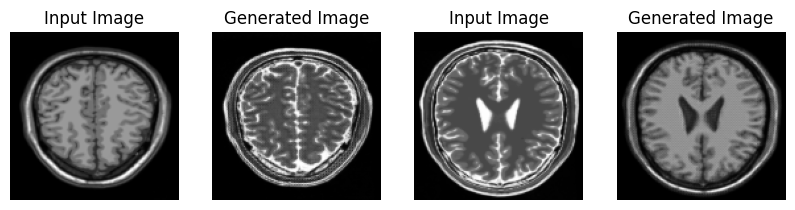

Checkpoint Saving for the epoch run  147 at ./CycleGANmodel/ckpt-147


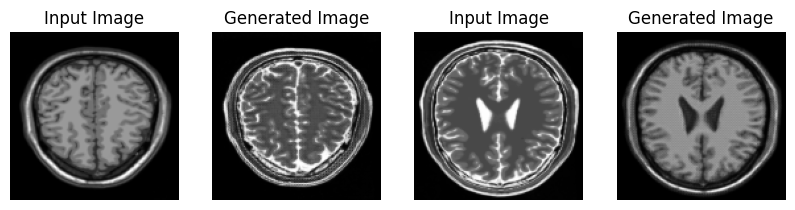

Checkpoint Saving for the epoch run  148 at ./CycleGANmodel/ckpt-148


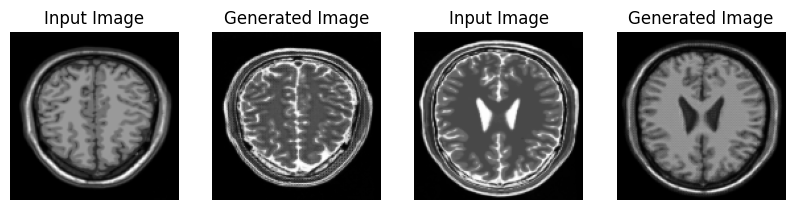

Checkpoint Saving for the epoch run  149 at ./CycleGANmodel/ckpt-149


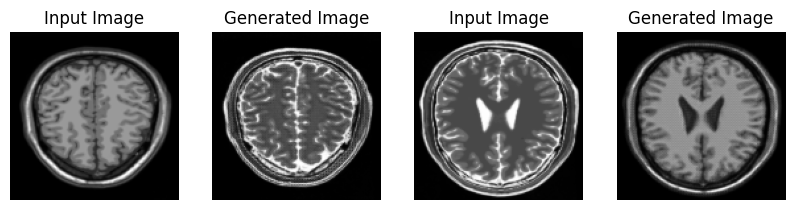

Checkpoint Saving for the epoch run  150 at ./CycleGANmodel/ckpt-150
CPU times: user 11min 34s, sys: 3min 25s, total: 15min
Wall time: 15min 11s


In [ ]:
%%time
for epoch in range(1, epochs+1):
  for t1, t2 in tf.data.Dataset.zip((t1imagesresized, t2imagesresized)): # providing whole T1 and T2 dataset for training
    result1, result2, result3, result4=train(t1, t2)
  gtlt1.append(result1)
  gtlt2.append(result2)
  dtlt1.append(result3)
  dtlt2.append(result4)

  generateimages(generator_t1, next(iter(t1trainimagedata)), generator_t2, next(iter(t2trainimagedata))) # inputting one type of T1 image and one type of T2 image to demonstrate improvements in cycle gan.
  checkpointsavepath=checkpointmanager.save()
  print('Checkpoint Saving for the epoch run ', epoch, 'at', checkpointsavepath)

After 150 epochs, the results are pretty good. The predicted images have a good likeness to their respective input image in terms of content, while having the style of the other image type.
1. Predicted T2 has the features of input T1 in the style of T2.
2. Predicted T1 has the features of input T2 in the style of T1.

#### Plotting Total Loss values of two Discriminators and two generators:

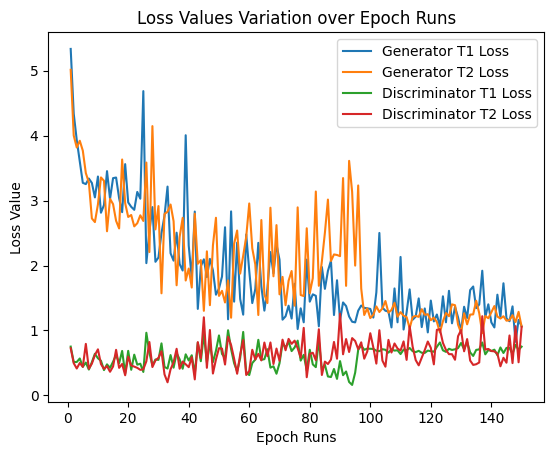

In [ ]:
plt.plot(np.arange(1,len(gtlt1)+1),gtlt1)
plt.plot(np.arange(1,len(gtlt2)+1),gtlt2)
plt.plot(np.arange(1,len(dtlt1)+1),dtlt1)
plt.plot(np.arange(1,len(dtlt2)+1),dtlt2)
plt.title('Loss Values Variation over Epoch Runs')
plt.ylabel('Loss Value')
plt.xlabel('Epoch Runs')
plt.legend(['Generator T1 Loss','Generator T2 Loss','Discriminator T1 Loss','Discriminator T2 Loss'])

- From the above graph, we can see that the Generator T1 and Generator T2 loss value seems to be stabilized after 100 epoch runs.
- Discriminator T1 loss increased by a small amount and maintained constant loss value after 100th epoch run.

### **Generating a GIF for Visualizing the Results:**

In [ ]:
giffiles=glob.glob('Image*.png')
giffiles=sorted(giffiles)

In [ ]:
giflist=[]
for i in giffiles:
  giflist.append(Image.open('/content/'+i))

In [ ]:
giflist[0].save('cyclegant1t2.gif',save_all=True,append_images=giflist[1:],duration=200,loop=0)

In [ ]:
import IPython.display as display

In [ ]:
from IPython.display import Image as im1

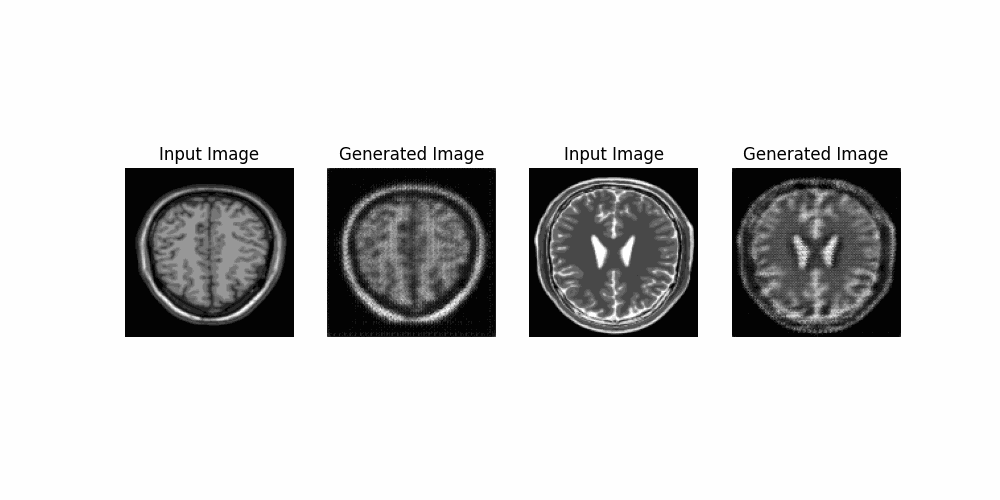

In [ ]:
im1(open('/content/cyclegant1t2.gif','rb').read())

### **Conclusion**
From the observed results it can be interpretted that a Cycle GAN architecture is effective in translating the style of T1 weighted MRI images to T2 weighted MRI image inputs, and vice versa.
This can be very useful in more effective diagnosis, without the need of a second MRI scan. This not only saves time for the doctors, but would also reduce the financial burden on the patients.